<a href="https://colab.research.google.com/github/sarashahin/Breast_Cancer_Detection_Attention-UNet_Segmentatio/blob/main/Breast_Cancer_Detection_Attention_UNet_Segmentatio.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'breast-ultrasound-images-dataset:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F1209633%2F2021025%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240801%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240801T202630Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D69383870e2b8321c78ee40cc9bfbd61fc64f661dfb371aa2c896d89f5a6c892e746177a5d58d5c7a84f958c4414d99b756befc63bc8e3a6cf835abd1f5711298c878325747cc72337789be7d6e0450ef95956a61f6fbcfe5c13cc9803fc5813986bd330085c096881bc79b85ddac3f849af108d7101054ecd7dd951cf62d106dc205a0c322846d2417a9f09b32312c253409a4db85aa5259c83bc57239144c07d28d43f53be956b0d1681b9903f88e789db6f82af10a735fa5dafec0e32b645e9b8042f0dbc27b2682c16c2a2ad59f7d30fa31737101dbfbfe116e22bea640963e68844c1301dd5616d4df77eadfb6cb22ffb258a41989019a6d57ff4f7f088a'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


In [ ]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

#  Introduction


**About the Dataset**


Breast cancer is one of the most common causes of death among women worldwide. Early detection significantly reduces death rates. This dataset includes breast ultrasound images used for early breast cancer diagnosis. The images are classified into three categories: normal, benign, and malignant.

**Key Details:**

Purpose: Early detection of breast cancer through ultrasound images.

Classes: Normal, Benign, Malignant.

Data Collection Year: 2018.

Participants: 600 female patients aged 25-75.

Number of Images: 780.

Image Size: Average of 500x500 pixels.

Format: PNG.

Annotations: Ground truth images are included for comparison.

In [ ]:
# !pip install tensorflow==2.13.0


In [ ]:
# !pip install tf_explain

In [ ]:
# !pip install tf-keras-vis



In [ ]:
# !pip install git+https://github.com/raghakot/keras-vis.git


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import Callback, ModelCheckpoint
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Dropout, MaxPool2D, UpSampling2D, concatenate, Add, Multiply, BatchNormalization, Layer, Input
from tensorflow.keras.metrics import MeanIoU
import tensorflow as tf
from glob import glob
import os


2024-08-01 20:16:36.862148: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-01 20:16:36.862269: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-01 20:16:37.008181: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [ ]:
#load and preprocess images
def load_image(image, SIZE):
    return np.round(tf.image.resize(img_to_array(load_img(image)) / 255., (SIZE, SIZE)), 4)

# load multiple images
def load_images(image_paths, SIZE, mask=False, trim=None):
    if trim is not None:
        image_paths = image_paths[:trim]

    if mask:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 1))
    else:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3))

    for i, image in enumerate(image_paths):
        img = load_image(image, SIZE)
        if mask:
            images[i] = img[:, :, :1]
        else:
            images[i] = img

    return images



In [ ]:
# display images
def show_image(image, title=None, cmap=None, alpha=1):
    plt.imshow(image, cmap=cmap, alpha=alpha)
    if title is not None:
        plt.title(title)
    plt.axis('off')

def show_mask(image, mask, cmap=None, alpha=0.4):
    plt.imshow(image)
    plt.imshow(tf.squeeze(mask), cmap=cmap, alpha=alpha)
    plt.axis('off')

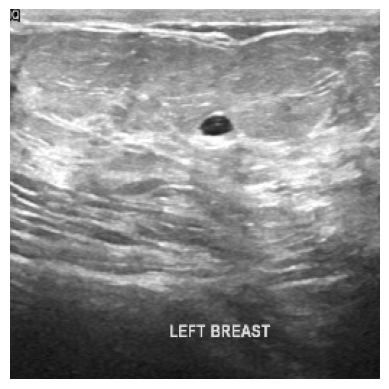

In [ ]:
# Loading data
SIZE = 256
root_path = '../input/breast-ultrasound-images-dataset/Dataset_BUSI_with_GT/'
classes = sorted(os.listdir(root_path))

single_mask_paths = sorted([sorted(glob(root_path + name + "/*mask.png")) for name in classes])
double_mask_paths = sorted([sorted(glob(root_path + name + "/*mask_1.png")) for name in classes])
image_paths = []
mask_paths = []
for class_path in single_mask_paths:
    for path in class_path:
        img_path = path.replace('_mask', '')
        image_paths.append(img_path)
        mask_paths.append(path)

# Displaying images
show_image(load_image(image_paths[0], SIZE))
plt.show()

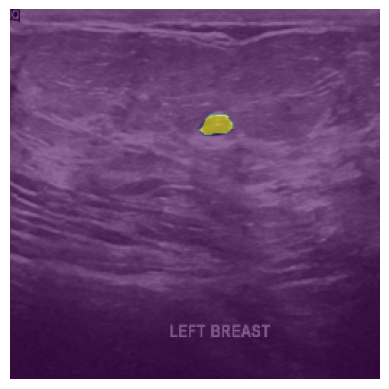

In [ ]:
show_mask(load_image(image_paths[0], SIZE), load_image(mask_paths[0], SIZE)[:, :, 0], alpha=0.6)
plt.show()



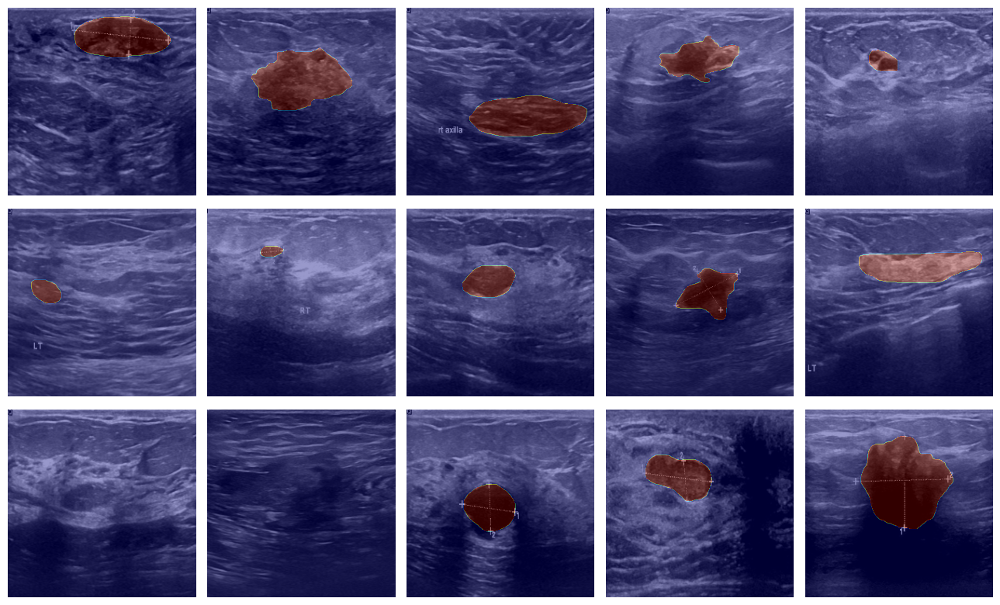

In [ ]:
images = load_images(image_paths, SIZE)
masks = load_images(mask_paths, SIZE, mask=True)
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='jet')
plt.tight_layout()
plt.show()

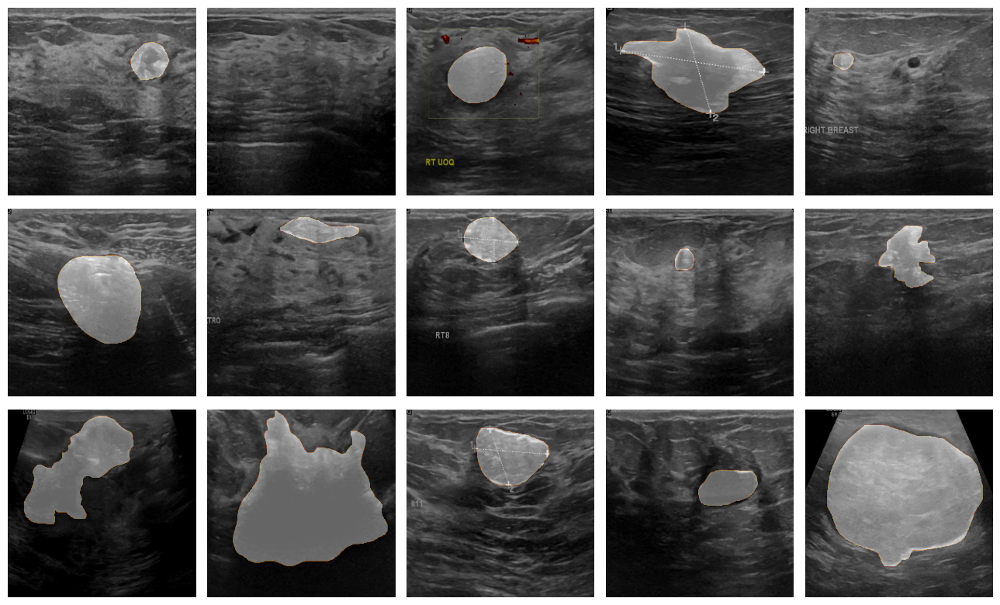

In [ ]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='afmhot')
plt.tight_layout()
plt.show()

In [ ]:
# Split the data into train, validation, and test sets
train_images, val_test_images, train_masks, val_test_masks = train_test_split(images, masks, test_size=0.4, random_state=42)
val_images, test_images, val_masks, test_masks = train_test_split(val_test_images, val_test_masks, test_size=0.5, random_state=42)

In [ ]:
# Encoder and Decoder Blocks
class EncoderBlock(Layer):
    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(EncoderBlock, self).__init__(**kwargs)
        self.filters = filters
        self.rate = rate
        self.pooling = pooling

        self.c1 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.drop = Dropout(rate)
        self.c2 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.pool = MaxPool2D()

    def call(self, x):
        x = self.c1(x)
        x = self.drop(x)
        x = self.c2(x)
        if self.pooling:
            y = self.pool(x)
            return y, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters": self.filters,
            'rate': self.rate,
            'pooling': self.pooling
        }

In [ ]:
class DecoderBlock(Layer):
    def __init__(self, filters, rate, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)
        self.filters = filters
        self.rate = rate

        self.up = UpSampling2D()
        self.net = EncoderBlock(filters, rate, pooling=False)

    def call(self, inputs):
        x, skip_x = inputs
        x = self.up(x)
        x = concatenate([x, skip_x])
        x = self.net(x)
        return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters": self.filters,
            'rate': self.rate,
        }



In [ ]:

class AttentionGate(Layer):
    def __init__(self, filters, bn=True, **kwargs):
        super(AttentionGate, self).__init__(**kwargs)
        self.filters = filters
        self.bn = bn

        self.normal = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer='he_normal')
        self.down = Conv2D(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.learn = Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')
        self.resample = UpSampling2D()
        self.bn_layer = BatchNormalization()

    def call(self, inputs):
        x, skip_x = inputs

        x = self.normal(x)
        skip = self.down(skip_x)
        x = Add()([x, skip])
        x = self.learn(x)
        x = self.resample(x)
        x = Multiply()([x, skip_x])
        if self.bn:
            return self.bn_layer(x)
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters": self.filters,
            "bn": self.bn
        }

In [ ]:
# Build and Compile Model
input_layer = Input(shape=(SIZE, SIZE, 3))

# Encoder
p1, c1 = EncoderBlock(32, 0.2, name="Encoder1")(input_layer)
p2, c2 = EncoderBlock(64, 0.3, name="Encoder2")(p1)
p3, c3 = EncoderBlock(128, 0.4, name="Encoder3")(p2)
p4, c4 = EncoderBlock(256, 0.5, name="Encoder4")(p3)

# Encoding
encoding = EncoderBlock(512, 0.6, pooling=False, name="Encoding")(p4)

# Attention + Decoder
a1 = AttentionGate(256, bn=True, name="Attention1")([encoding, c4])
d1 = DecoderBlock(256, 0.2, name="Decoder1")([encoding, a1])

a2 = AttentionGate(128, bn=True, name="Attention2")([d1, c3])
d2 = DecoderBlock(128, 0.2, name="Decoder2")([d1, a2])

a3 = AttentionGate(64, bn=True, name="Attention3")([d2, c2])
d3 = DecoderBlock(64, 0.1, name="Decoder3")([d2, a3])

a4 = AttentionGate(32, bn=True, name="Attention4")([d3, c1])
d4 = DecoderBlock(32, 0.1, name="Decoder4")([d3, a4])

# Output
output_layer = Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(d4)

# Model
model = Model(inputs=[input_layer], outputs=[output_layer])

# Compile the model with required metrics and loss function
optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.00001, clipvalue=1.0)
model.compile(
    loss='binary_crossentropy',
    optimizer=optimizer,
    metrics=['accuracy', MeanIoU(num_classes=2, name='IoU')]
)




/opt/conda/lib/python3.10/site-packages/keras/src/layers/layer.py:372: UserWarning: `build()` was called on layer 'Encoding', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/layers/layer.py:372: UserWarning: `build()` was called on layer 'encoder_block', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/keras/src/layers/layer.py:372: UserWarning: `build()` was called on layer 'encoder_block_1', however the layer does n

In [ ]:
# Custom callback for visualizing predictions
class ShowPredictions(Callback):
    def __init__(self, images, masks):
        super(ShowPredictions, self).__init__()
        self.images = images
        self.masks = masks

    def on_epoch_end(self, epoch, logs=None):
        idx = np.random.randint(len(self.images))
        image = self.images[idx]
        mask = self.masks[idx]
        pred_mask = self.model.predict(image[np.newaxis, ...])[0]

        plt.figure(figsize=(10, 5))

        plt.subplot(1, 3, 1)
        plt.title("Original Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1, 3, 2)
        plt.title("Predicted Mask")
        show_mask(image, pred_mask, cmap='copper')

        plt.subplot(1, 3, 3)
        plt.title("Prediction Heatmap")
        plt.imshow(image)
        plt.imshow(pred_mask, cmap='jet', alpha=0.5)
        plt.axis('off')

        plt.tight_layout()
        plt.show()

# Callbacks
cb = [
    ModelCheckpoint("AttentionCustomUNet.keras", save_best_only=True),
    ShowPredictions(val_images, val_masks)
]


# print(model.summary())



Checking for NaNs in training images: 0
Checking for NaNs in training masks: 0
Checking for NaNs in validation images: 0
Checking for NaNs in validation masks: 0
Epoch 1/50


2024-08-01 20:17:36.146015: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 3.1309, expected 2.65729
2024-08-01 20:17:36.146262: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 27392: 3.36129, expected 2.88768
2024-08-01 20:17:36.146389: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 38656: 3.56606, expected 3.09244
2024-08-01 20:17:36.147024: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 131072: 2.58553, expected 1.63582
2024-08-01 20:17:36.147055: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 131073: 3.91803, expected 2.96832
2024-08-01 20:17:36.147071: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 131074: 2.80043, expected 1.85073
2024-08-01 20:17:36.147091: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 131075: 4.68346, expected 3.73375
2024-08-01 20:17:36.147105: 

29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step - IoU: 0.4476 - accuracy: 0.8306 - loss: 16.6439

2024-08-01 20:18:31.036812: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 3.6476, expected 2.72011
2024-08-01 20:18:31.036873: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 3.96832, expected 3.04084
2024-08-01 20:18:31.036883: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 2: 5.00374, expected 4.07625
2024-08-01 20:18:31.036891: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 3: 5.4973, expected 4.56981
2024-08-01 20:18:31.036899: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 4: 5.1816, expected 4.25411
2024-08-01 20:18:31.036906: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 5: 5.73813, expected 4.81064
2024-08-01 20:18:31.036916: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 6: 5.68741, expected 4.75992
2024-08-01 20:18:31.036924: E external/local_xla/xla/servi

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


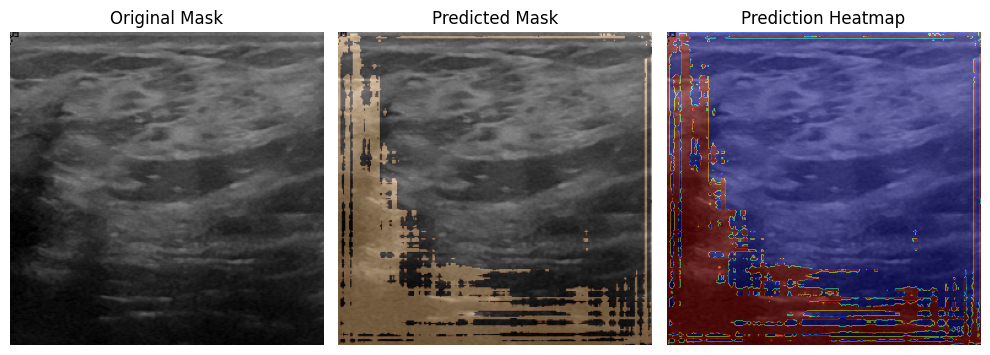

29/29 ━━━━━━━━━━━━━━━━━━━━ 89s 975ms/step - IoU: 0.4468 - accuracy: 0.8309 - loss: 17.0704 - val_IoU: 0.4646 - val_accuracy: 0.9181 - val_loss: 9.9928
Epoch 2/50


2024-08-01 20:18:56.338390: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 0: 3.35047, expected 2.80959
2024-08-01 20:18:56.338450: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 1: 3.81961, expected 3.27872
2024-08-01 20:18:56.338459: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 8: 4.35367, expected 3.81278
2024-08-01 20:18:56.338469: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 21: 3.87151, expected 3.33062
2024-08-01 20:18:56.338476: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 30: 4.11246, expected 3.57157
2024-08-01 20:18:56.338484: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 31: 4.24547, expected 3.70459
2024-08-01 20:18:56.338492: E external/local_xla/xla/service/gpu/buffer_comparator.cc:1137] Difference at 32: 3.83231, expected 3.29143
2024-08-01 20:18:56.338499: E external/local_xla/xl

 1/29 ━━━━━━━━━━━━━━━━━━━━ 14:47 32s/step - IoU: 0.2889 - accuracy: 0.4843 - loss: 448.4592

/opt/conda/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


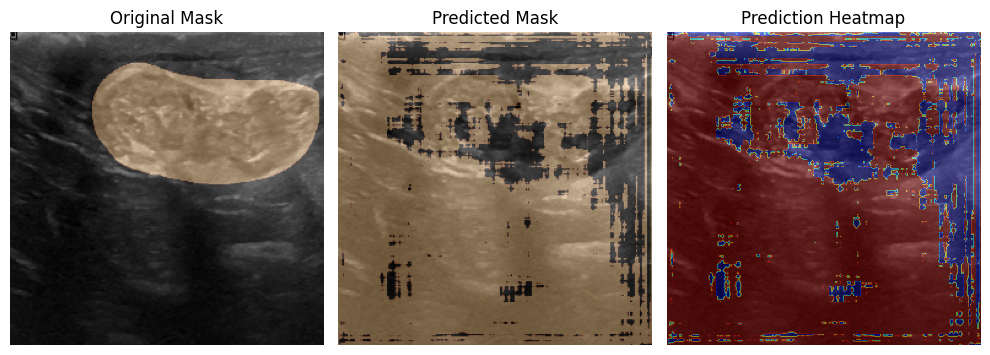

29/29 ━━━━━━━━━━━━━━━━━━━━ 33s 62ms/step - IoU: 0.2889 - accuracy: 0.4843 - loss: 448.4592 - val_IoU: 0.4644 - val_accuracy: 0.9145 - val_loss: 8.8015
Epoch 3/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4398 - accuracy: 0.8455 - loss: 96.432


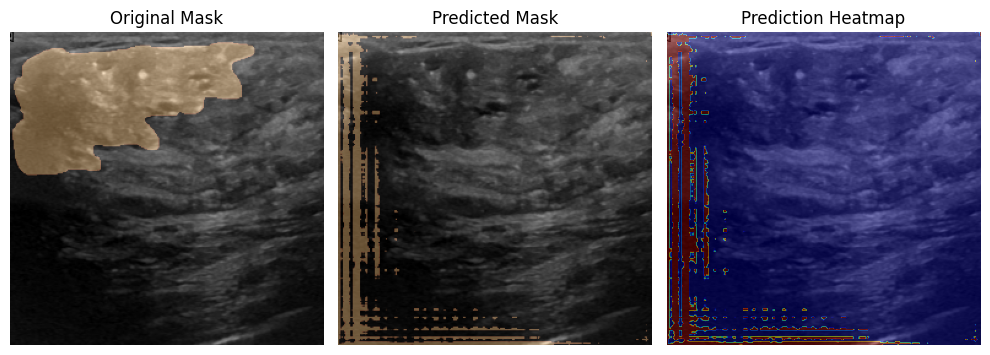

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4390 - accuracy: 0.8456 - loss: 98.4501 - val_IoU: 0.4648 - val_accuracy: 0.9264 - val_loss: 65.0428
Epoch 4/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.3066 - accuracy: 0.5801 - loss: 1039.676


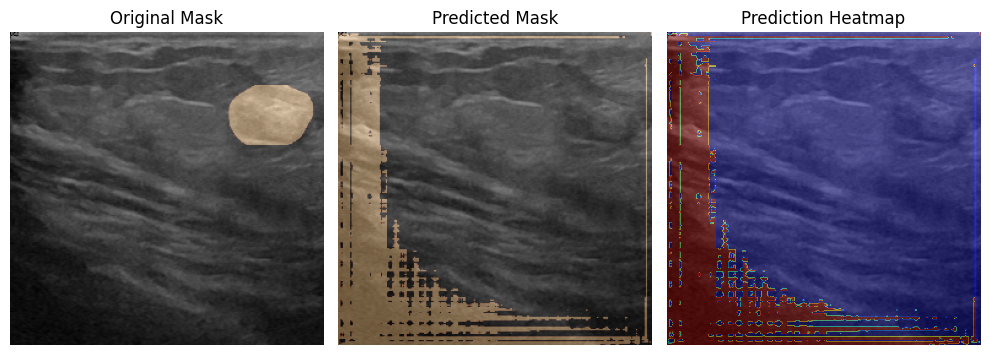

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 42ms/step - IoU: 0.3066 - accuracy: 0.5801 - loss: 1039.6768 - val_IoU: 0.4643 - val_accuracy: 0.9245 - val_loss: 52.2839
Epoch 5/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4383 - accuracy: 0.8493 - loss: 305.149


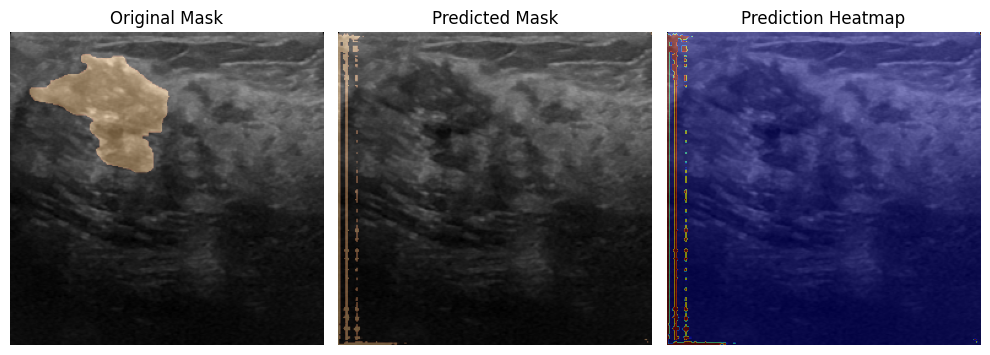

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 221ms/step - IoU: 0.4374 - accuracy: 0.8493 - loss: 309.2814 - val_IoU: 0.4648 - val_accuracy: 0.9272 - val_loss: 170.8156
Epoch 6/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.3530 - accuracy: 0.6381 - loss: 1448.556


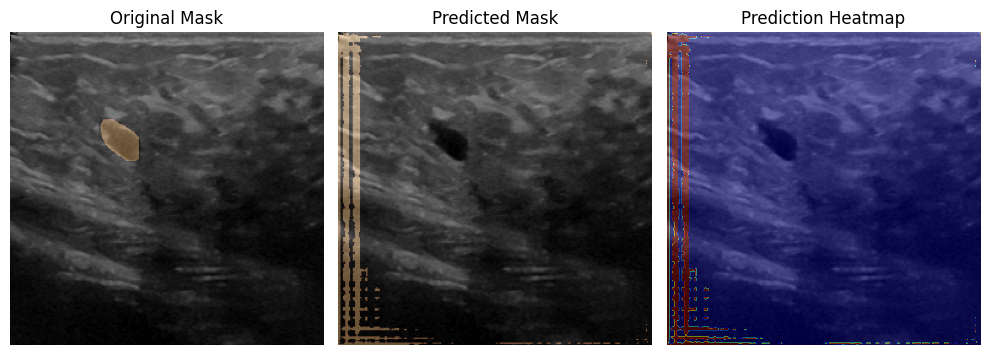

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.3530 - accuracy: 0.6381 - loss: 1448.5563 - val_IoU: 0.4648 - val_accuracy: 0.9271 - val_loss: 144.8970
Epoch 7/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4399 - accuracy: 0.8545 - loss: 850.610


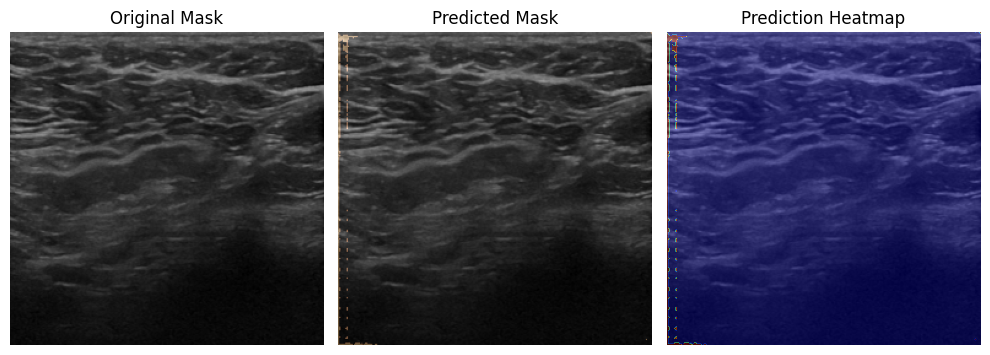

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 220ms/step - IoU: 0.4390 - accuracy: 0.8545 - loss: 861.7665 - val_IoU: 0.4647 - val_accuracy: 0.9273 - val_loss: 466.2430
Epoch 8/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step 0.3839 - accuracy: 0.7110 - loss: 2980.461


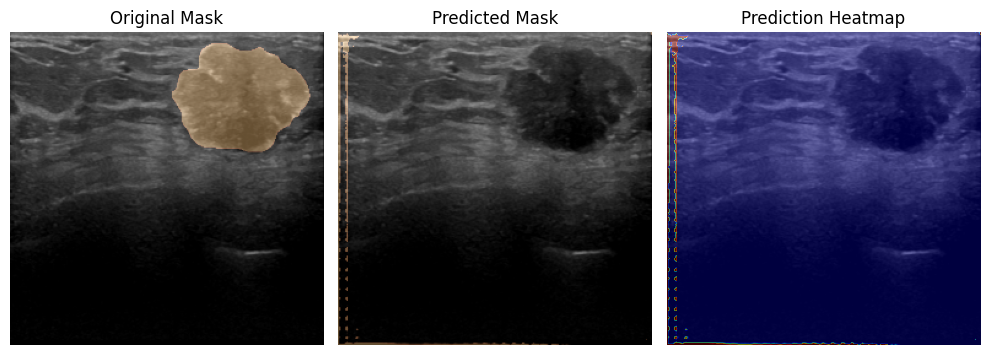

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - IoU: 0.3839 - accuracy: 0.7110 - loss: 2980.4614 - val_IoU: 0.4647 - val_accuracy: 0.9273 - val_loss: 408.6234
Epoch 9/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - IoU: 0.4405 - accuracy: 0.8560 - loss: 2413.130


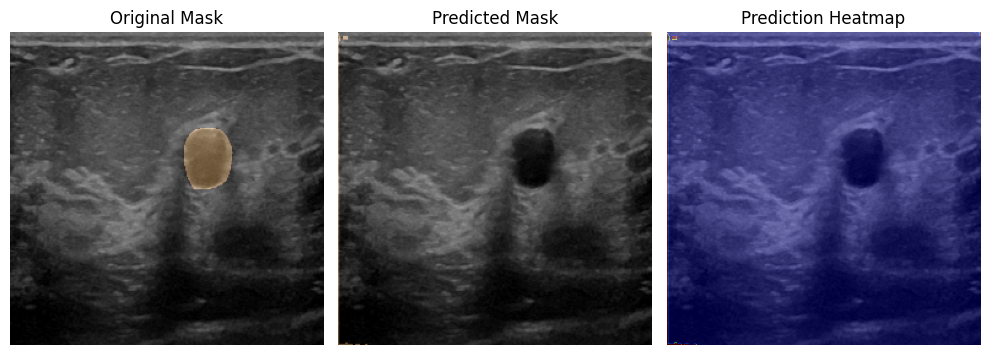

29/29 ━━━━━━━━━━━━━━━━━━━━ 7s 225ms/step - IoU: 0.4396 - accuracy: 0.8558 - loss: 2450.1726 - val_IoU: 0.4647 - val_accuracy: 0.9274 - val_loss: 1547.6838
Epoch 10/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4069 - accuracy: 0.7729 - loss: 6714.831


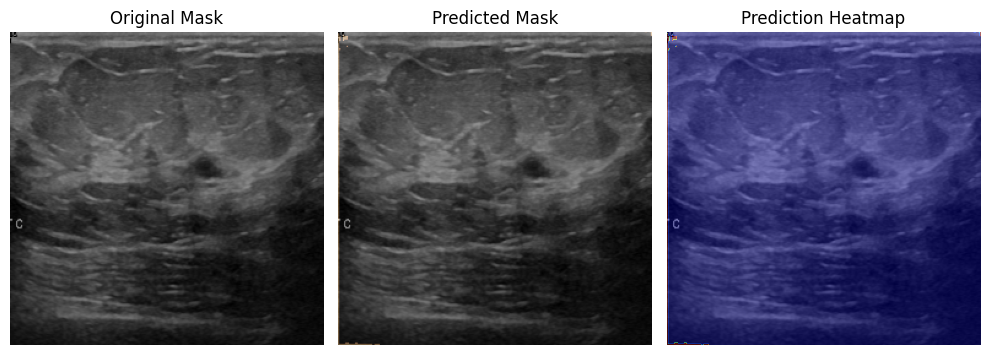

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4069 - accuracy: 0.7729 - loss: 6714.8311 - val_IoU: 0.4647 - val_accuracy: 0.9274 - val_loss: 1427.0670
Epoch 11/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4391 - accuracy: 0.8521 - loss: 7724.968


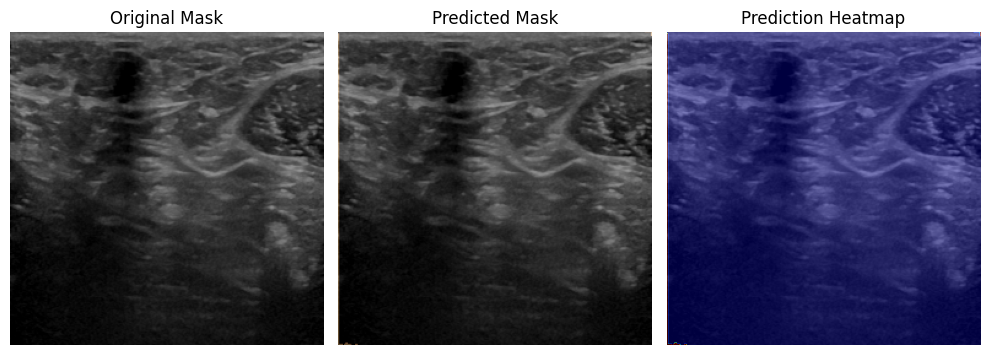

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 223ms/step - IoU: 0.4383 - accuracy: 0.8522 - loss: 7823.9756 - val_IoU: 0.4647 - val_accuracy: 0.9275 - val_loss: 4858.5210
Epoch 12/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4285 - accuracy: 0.8293 - loss: 15013.938


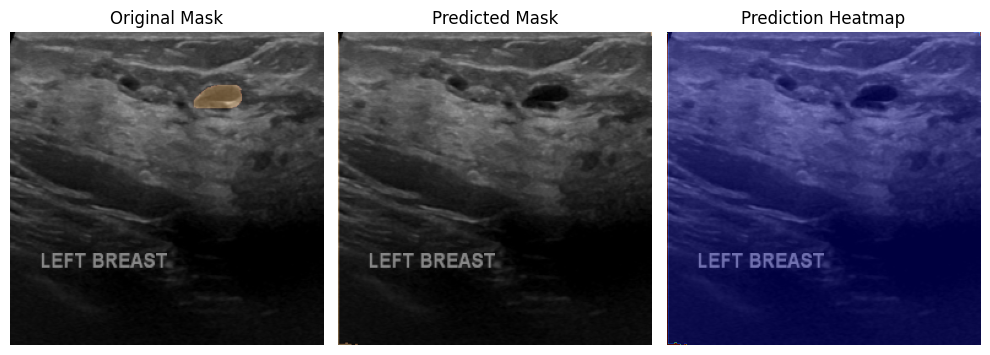

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4285 - accuracy: 0.8293 - loss: 15013.9385 - val_IoU: 0.4648 - val_accuracy: 0.9275 - val_loss: 4559.0146
Epoch 13/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4409 - accuracy: 0.8562 - loss: 24027.168


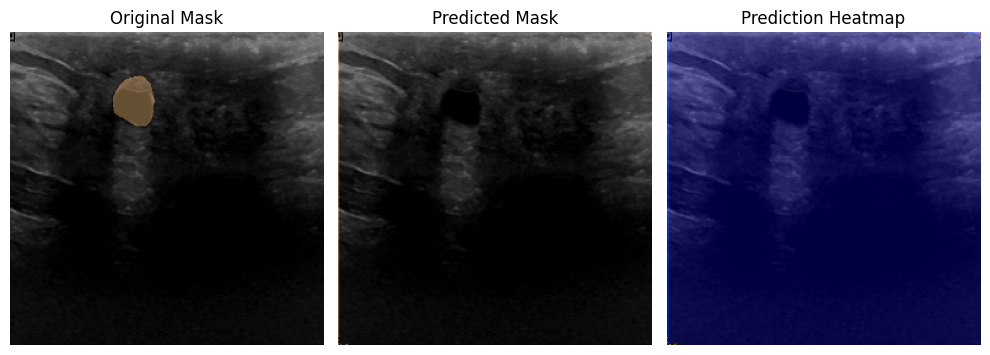

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 220ms/step - IoU: 0.4401 - accuracy: 0.8562 - loss: 24335.5547 - val_IoU: 0.4647 - val_accuracy: 0.9273 - val_loss: 16659.3770
Epoch 14/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4349 - accuracy: 0.8447 - loss: 42774.039


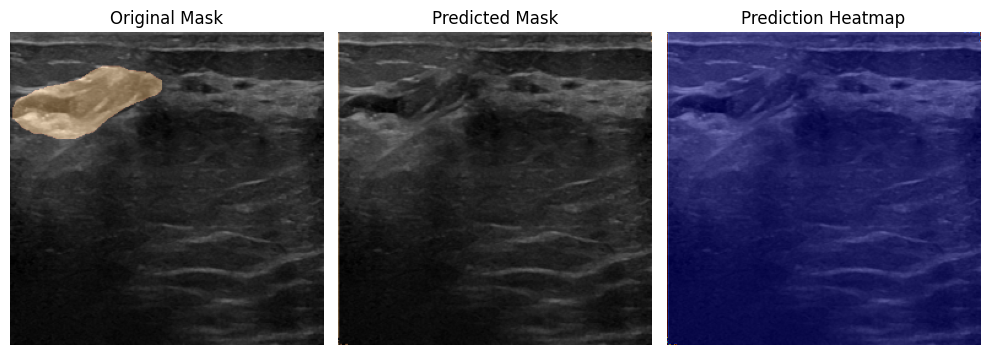

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - IoU: 0.4349 - accuracy: 0.8447 - loss: 42774.0391 - val_IoU: 0.4647 - val_accuracy: 0.9274 - val_loss: 15933.1846
Epoch 15/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4389 - accuracy: 0.8510 - loss: 73656.562


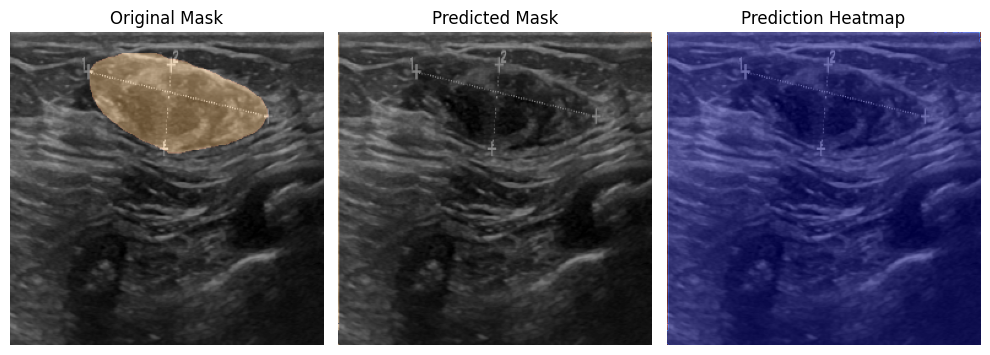

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4382 - accuracy: 0.8512 - loss: 73978.5781 - val_IoU: 0.4645 - val_accuracy: 0.9271 - val_loss: 39040.7812
Epoch 16/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4359 - accuracy: 0.8232 - loss: 113005.945


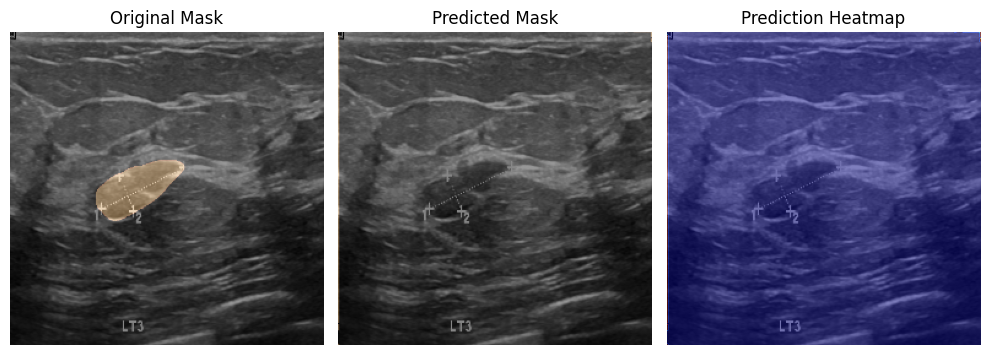

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4359 - accuracy: 0.8232 - loss: 113005.9453 - val_IoU: 0.4647 - val_accuracy: 0.9273 - val_loss: 37563.5820
Epoch 17/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4386 - accuracy: 0.8503 - loss: 175288.968


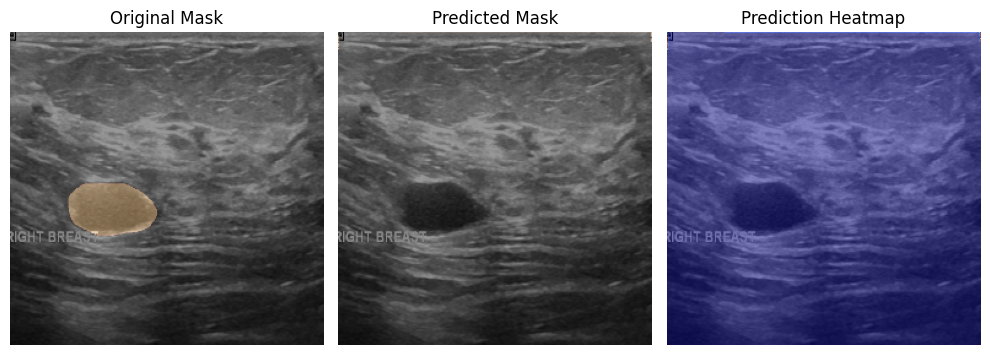

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 221ms/step - IoU: 0.4379 - accuracy: 0.8506 - loss: 175951.4531 - val_IoU: 0.4635 - val_accuracy: 0.9250 - val_loss: 88634.3906
Epoch 18/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step 0.4392 - accuracy: 0.8353 - loss: 296482.312


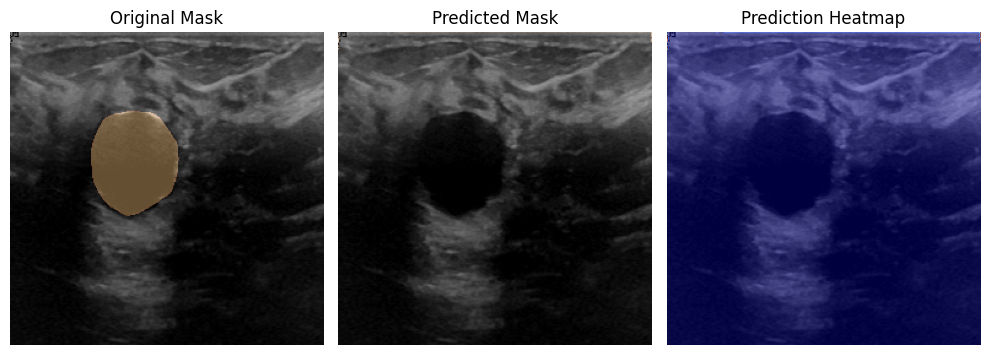

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - IoU: 0.4392 - accuracy: 0.8353 - loss: 296482.3125 - val_IoU: 0.4635 - val_accuracy: 0.9249 - val_loss: 93621.3672
Epoch 19/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/steptep - IoU: 0.4435 - accuracy: 0.8641 - loss: 357649.031


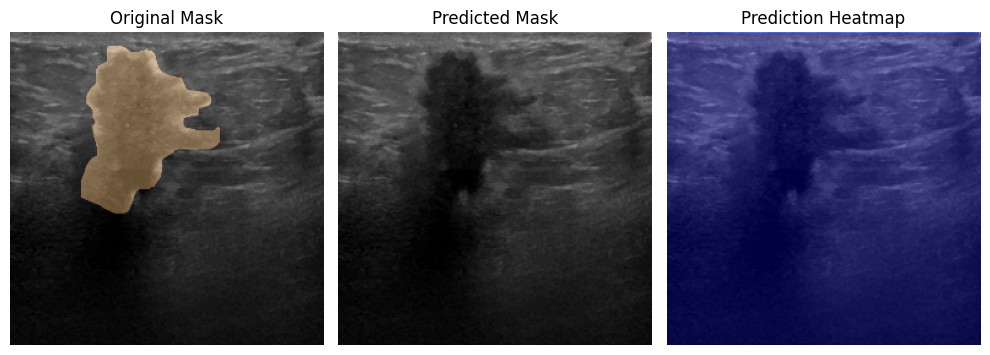

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4427 - accuracy: 0.8639 - loss: 360639.3438 - val_IoU: 0.4633 - val_accuracy: 0.9246 - val_loss: 214562.4688
Epoch 20/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step 0.4421 - accuracy: 0.8427 - loss: 599323.062


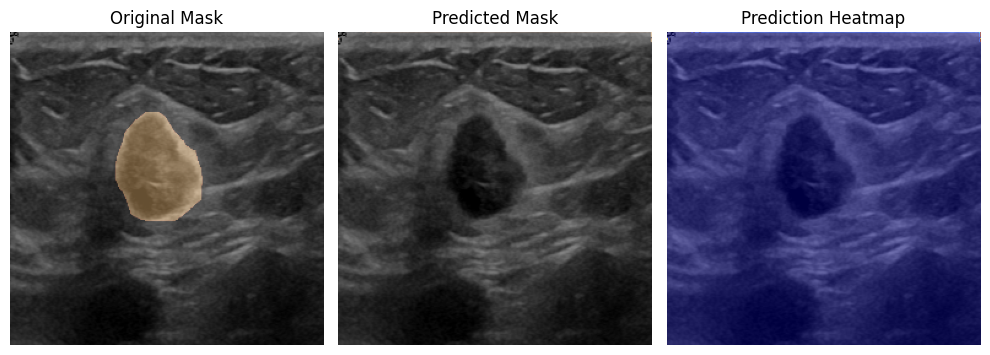

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4421 - accuracy: 0.8427 - loss: 599323.0625 - val_IoU: 0.4633 - val_accuracy: 0.9246 - val_loss: 218270.1094
Epoch 21/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4408 - accuracy: 0.8562 - loss: 818902.312


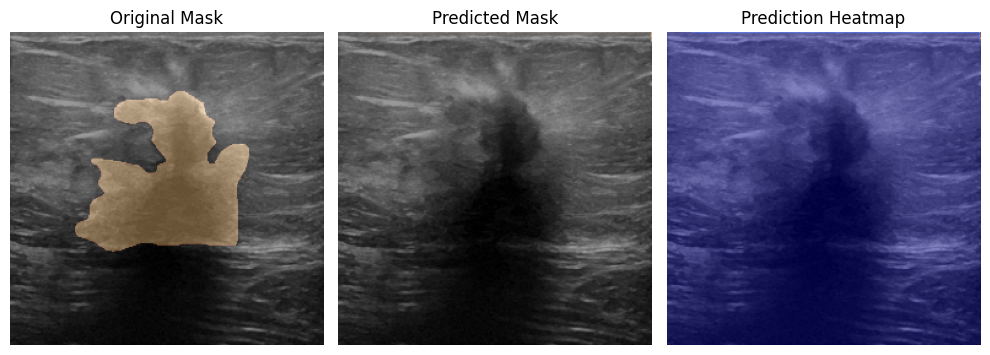

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4400 - accuracy: 0.8563 - loss: 823018.0625 - val_IoU: 0.4633 - val_accuracy: 0.9246 - val_loss: 430635.2188
Epoch 22/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step 0.4512 - accuracy: 0.8880 - loss: 602379.000


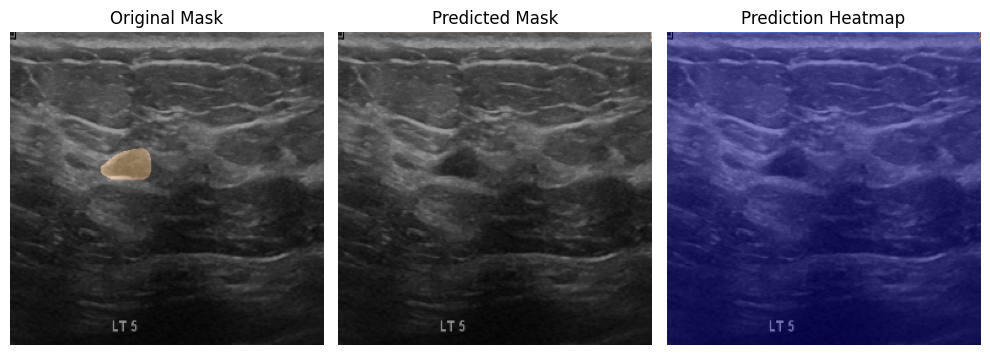

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4512 - accuracy: 0.8880 - loss: 602379.0000 - val_IoU: 0.4634 - val_accuracy: 0.9247 - val_loss: 418850.3750
Epoch 23/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4437 - accuracy: 0.8639 - loss: 1391754.750


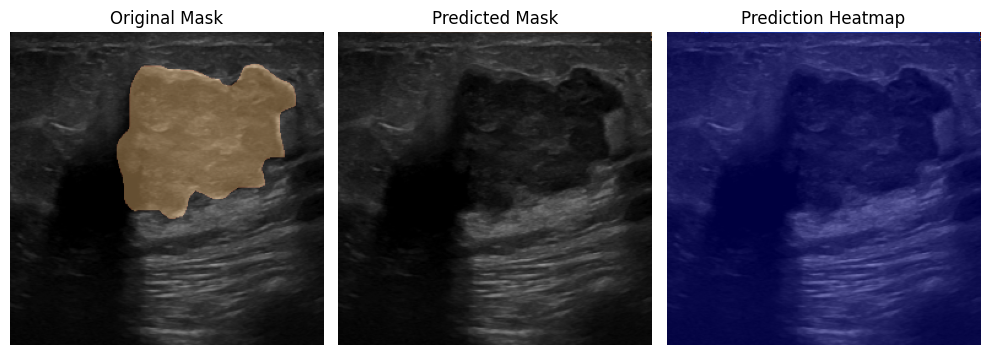

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4429 - accuracy: 0.8638 - loss: 1400351.8750 - val_IoU: 0.4635 - val_accuracy: 0.9249 - val_loss: 765173.5625
Epoch 24/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4544 - accuracy: 0.8974 - loss: 862250.375


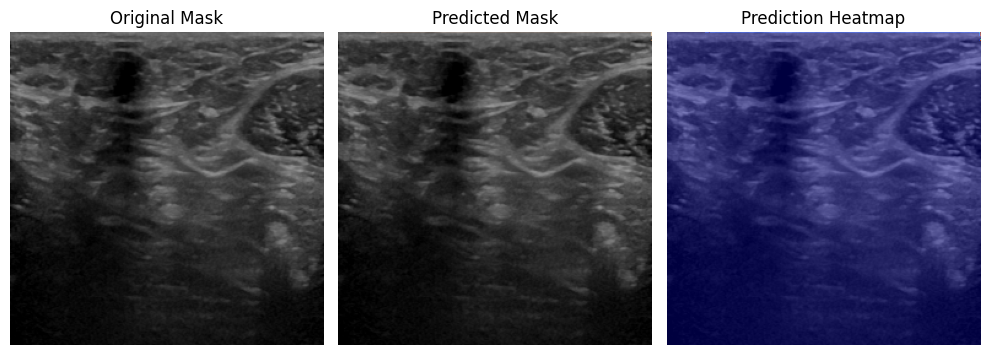

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - IoU: 0.4544 - accuracy: 0.8974 - loss: 862250.3750 - val_IoU: 0.4640 - val_accuracy: 0.9261 - val_loss: 745780.8125
Epoch 25/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4457 - accuracy: 0.8696 - loss: 2254235.250


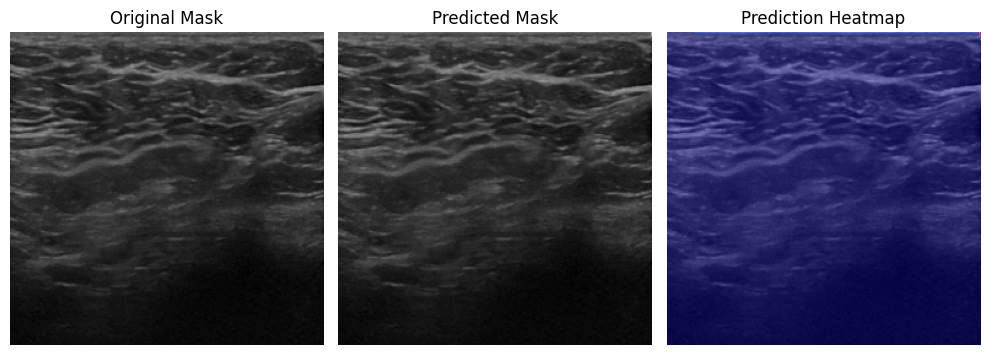

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 221ms/step - IoU: 0.4448 - accuracy: 0.8693 - loss: 2277214.2500 - val_IoU: 0.4635 - val_accuracy: 0.9249 - val_loss: 1502817.2500
Epoch 26/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4461 - accuracy: 0.8562 - loss: 4034865.750


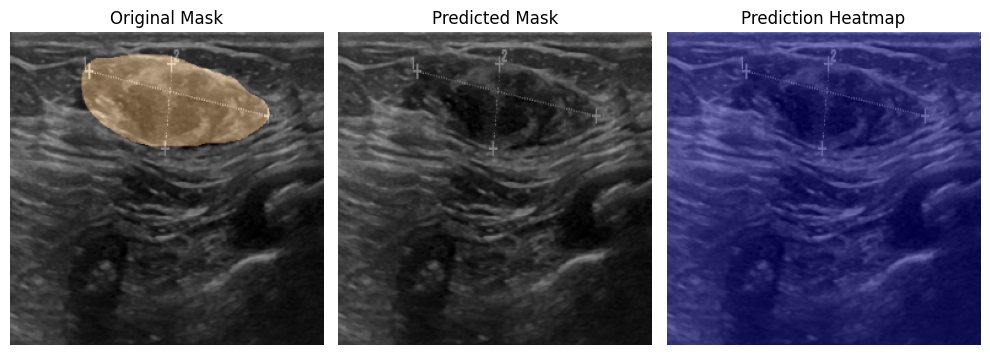

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4461 - accuracy: 0.8562 - loss: 4034865.7500 - val_IoU: 0.4635 - val_accuracy: 0.9250 - val_loss: 1537607.0000
Epoch 27/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/steptep - IoU: 0.4372 - accuracy: 0.8457 - loss: 5424010.000


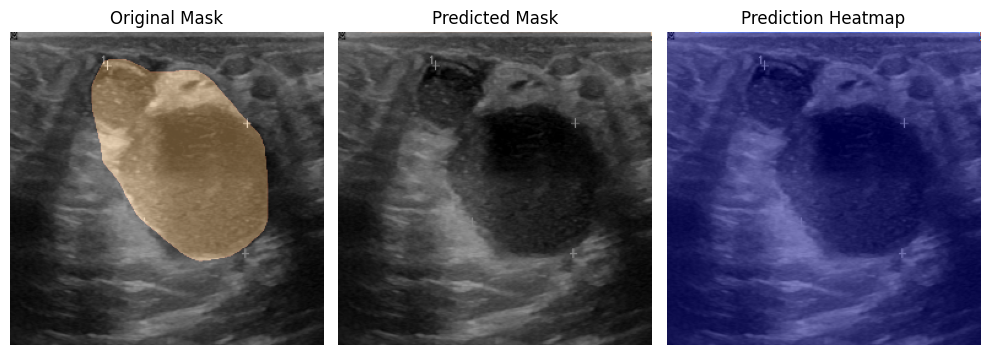

29/29 ━━━━━━━━━━━━━━━━━━━━ 7s 234ms/step - IoU: 0.4365 - accuracy: 0.8459 - loss: 5438768.0000 - val_IoU: 0.4639 - val_accuracy: 0.9258 - val_loss: 2813382.0000
Epoch 28/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4529 - accuracy: 0.8972 - loss: 3089950.500


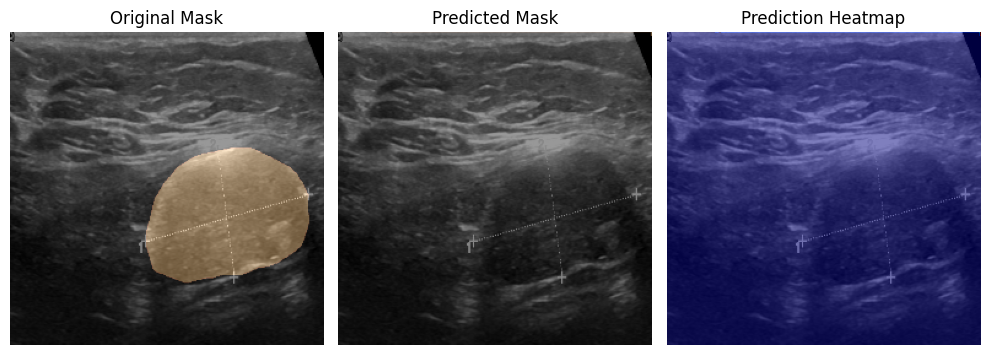

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - IoU: 0.4529 - accuracy: 0.8972 - loss: 3089950.5000 - val_IoU: 0.4647 - val_accuracy: 0.9273 - val_loss: 2747424.2500
Epoch 29/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4415 - accuracy: 0.8575 - loss: 8548265.000


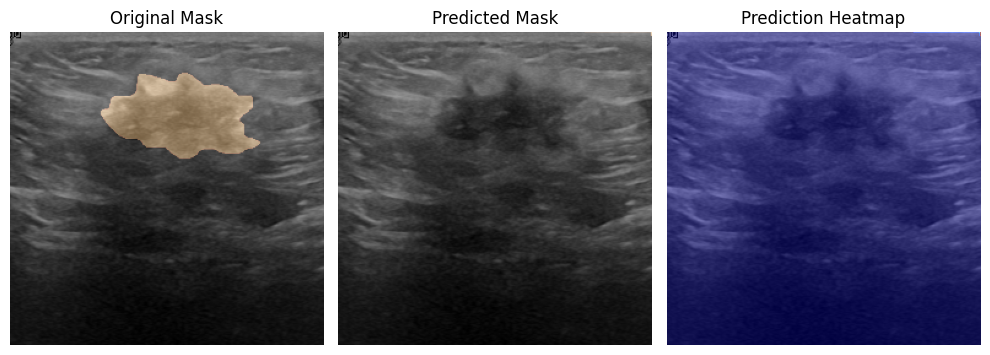

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 221ms/step - IoU: 0.4406 - accuracy: 0.8573 - loss: 8608772.0000 - val_IoU: 0.4649 - val_accuracy: 0.9277 - val_loss: 5122192.5000
Epoch 30/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4313 - accuracy: 0.8107 - loss: 19724114.000


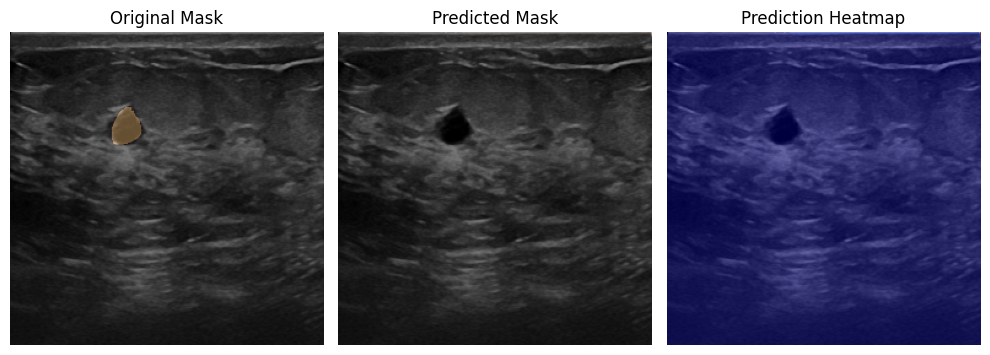

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - IoU: 0.4313 - accuracy: 0.8107 - loss: 19724114.0000 - val_IoU: 0.4648 - val_accuracy: 0.9275 - val_loss: 5317291.0000
Epoch 31/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4407 - accuracy: 0.8557 - loss: 14537986.000


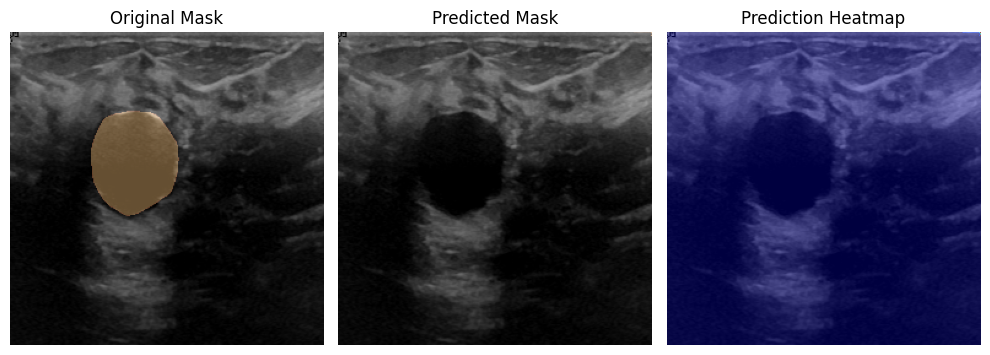

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 223ms/step - IoU: 0.4399 - accuracy: 0.8557 - loss: 14561251.0000 - val_IoU: 0.4650 - val_accuracy: 0.9280 - val_loss: 6668032.5000
Epoch 32/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4358 - accuracy: 0.8299 - loss: 22450624.000


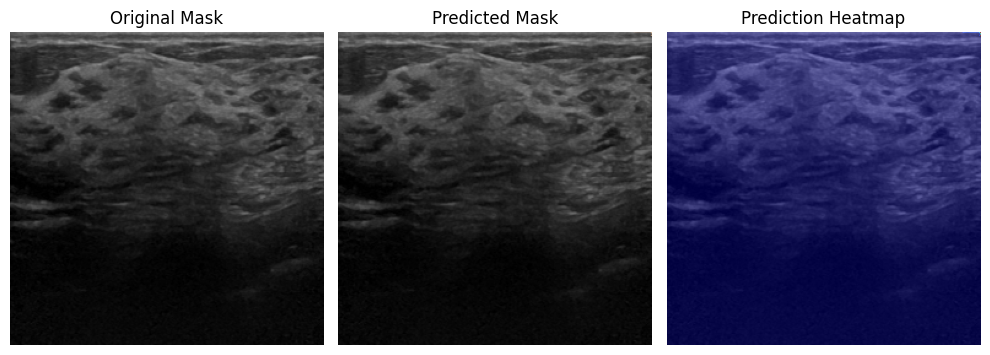

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4358 - accuracy: 0.8299 - loss: 22450624.0000 - val_IoU: 0.4650 - val_accuracy: 0.9280 - val_loss: 6884043.5000
Epoch 33/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - IoU: 0.4395 - accuracy: 0.8518 - loss: 21514568.000


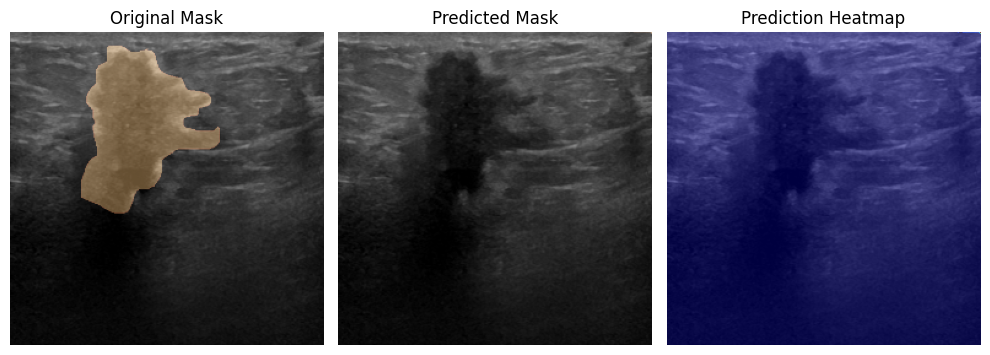

29/29 ━━━━━━━━━━━━━━━━━━━━ 7s 225ms/step - IoU: 0.4387 - accuracy: 0.8517 - loss: 21604512.0000 - val_IoU: 0.4650 - val_accuracy: 0.9280 - val_loss: 11320786.0000
Epoch 34/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4539 - accuracy: 0.8936 - loss: 13318599.000


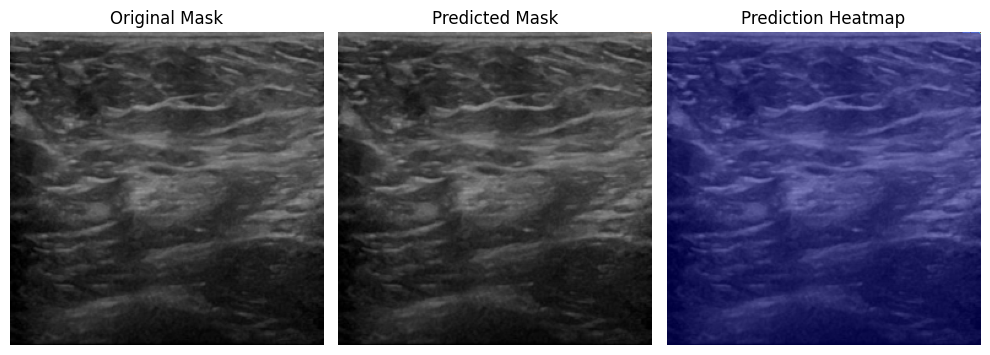

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4539 - accuracy: 0.8936 - loss: 13318599.0000 - val_IoU: 0.4650 - val_accuracy: 0.9281 - val_loss: 11092350.0000
Epoch 35/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4398 - accuracy: 0.8524 - loss: 31812224.000


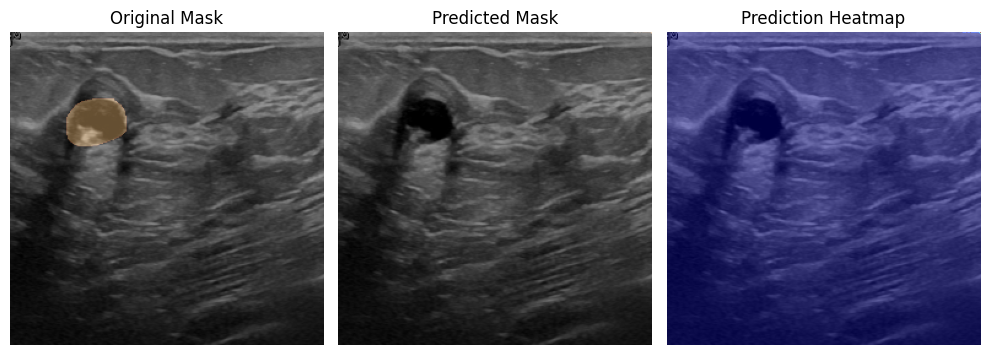

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4390 - accuracy: 0.8525 - loss: 31892110.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 15610327.0000
Epoch 36/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step 0.4188 - accuracy: 0.7831 - loss: 71677072.000


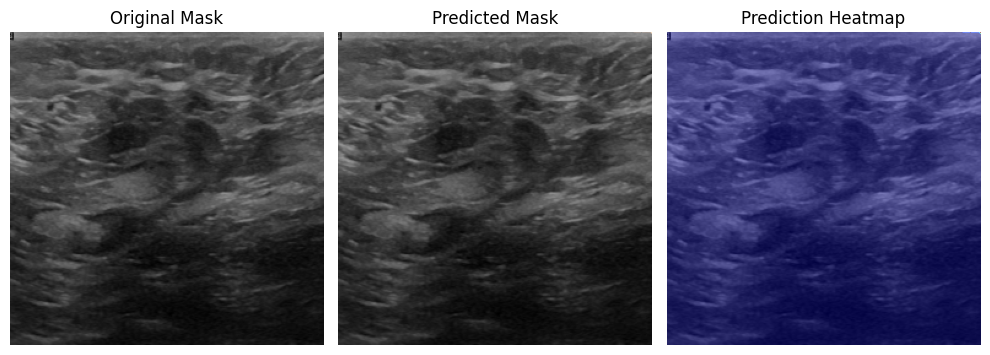

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 37ms/step - IoU: 0.4188 - accuracy: 0.7831 - loss: 71677072.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 16163264.0000
Epoch 37/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - IoU: 0.4369 - accuracy: 0.8440 - loss: 48230684.000


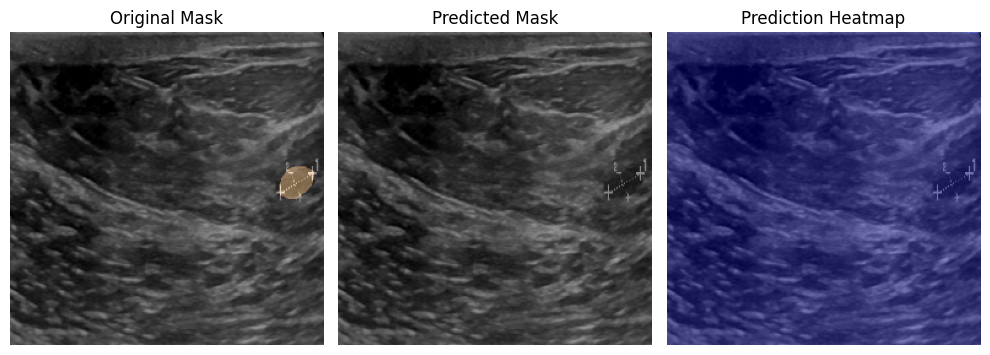

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 221ms/step - IoU: 0.4361 - accuracy: 0.8442 - loss: 48226624.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 22839480.0000
Epoch 38/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4257 - accuracy: 0.7975 - loss: 61913304.000


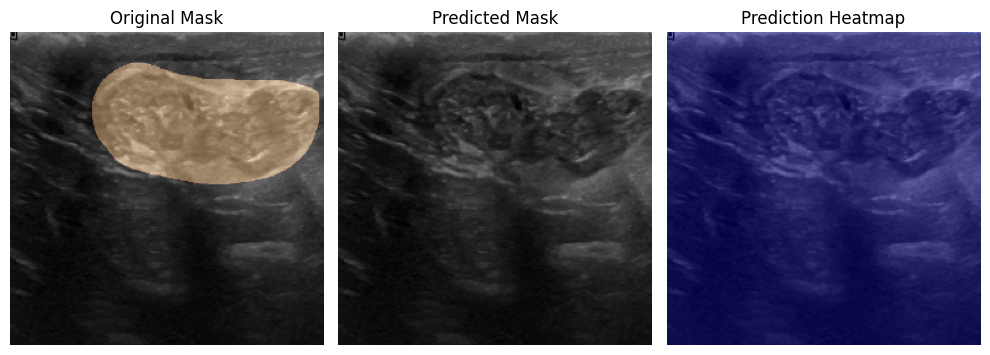

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - IoU: 0.4257 - accuracy: 0.7975 - loss: 61913304.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 23653646.0000
Epoch 39/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4366 - accuracy: 0.8434 - loss: 69695928.000


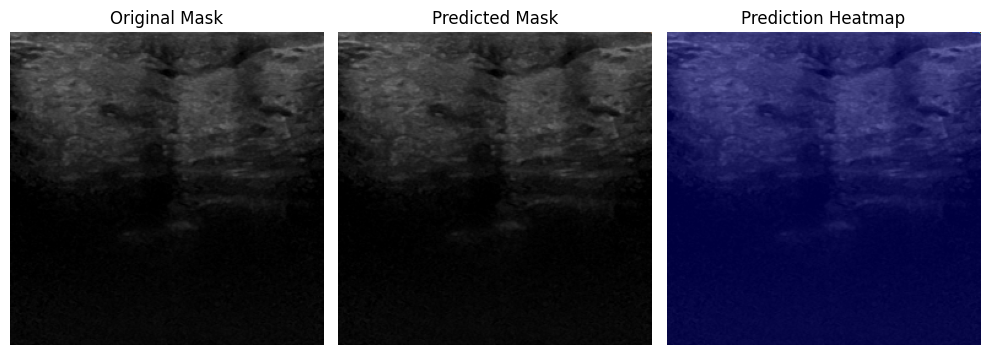

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 223ms/step - IoU: 0.4359 - accuracy: 0.8436 - loss: 69813072.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 31777092.0000
Epoch 40/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4484 - accuracy: 0.8613 - loss: 85233376.000


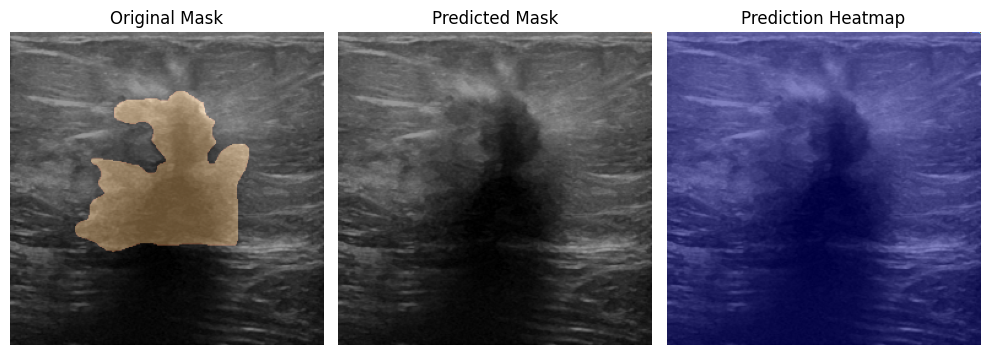

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4484 - accuracy: 0.8613 - loss: 85233376.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 32665026.0000
Epoch 41/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4411 - accuracy: 0.8561 - loss: 89128192.000


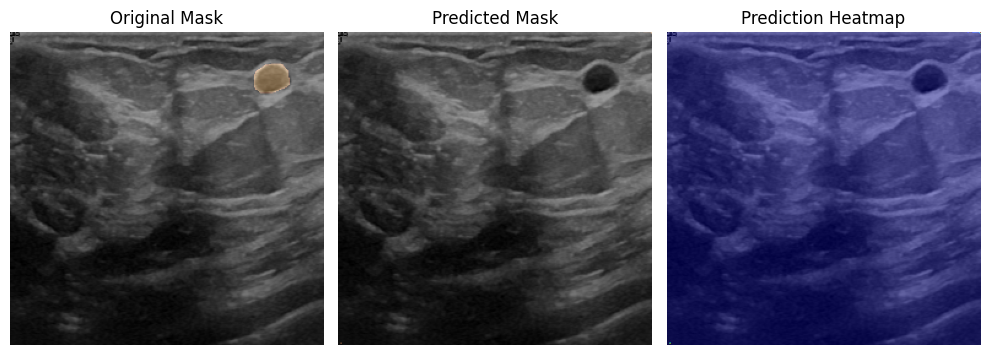

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 222ms/step - IoU: 0.4401 - accuracy: 0.8559 - loss: 89489136.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 45249940.0000
Epoch 42/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4465 - accuracy: 0.8584 - loss: 75106824.000


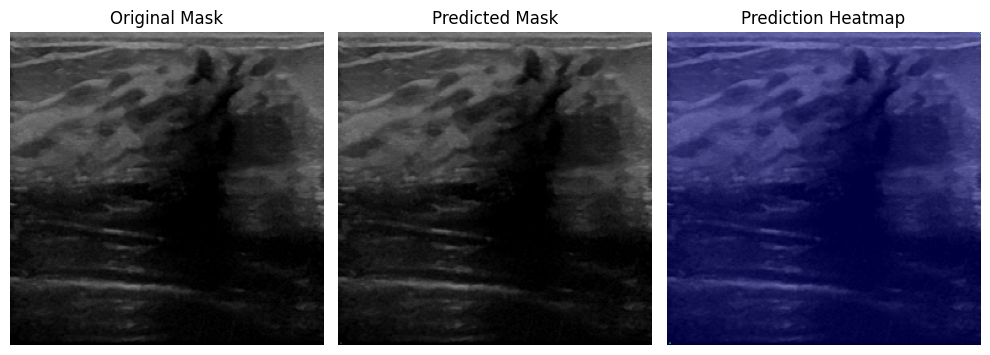

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - IoU: 0.4465 - accuracy: 0.8584 - loss: 75106824.0000 - val_IoU: 0.4651 - val_accuracy: 0.9281 - val_loss: 44253824.0000
Epoch 43/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4370 - accuracy: 0.8446 - loss: 127467336.000


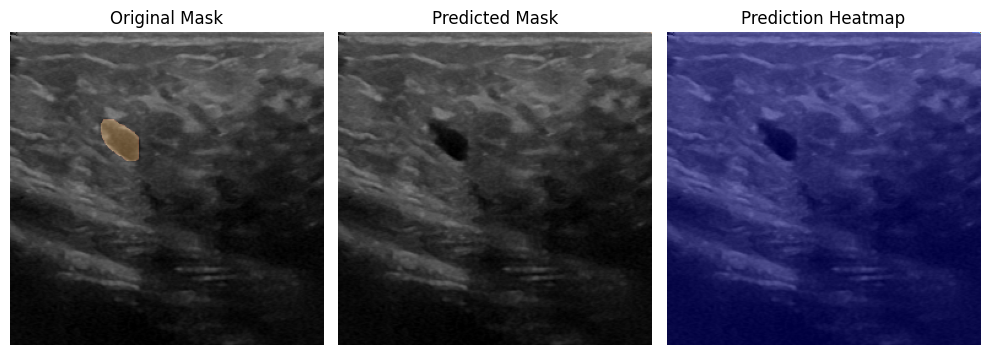

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 224ms/step - IoU: 0.4362 - accuracy: 0.8448 - loss: 127477728.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 59899792.0000
Epoch 44/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step 0.4239 - accuracy: 0.7979 - loss: 256986368.000


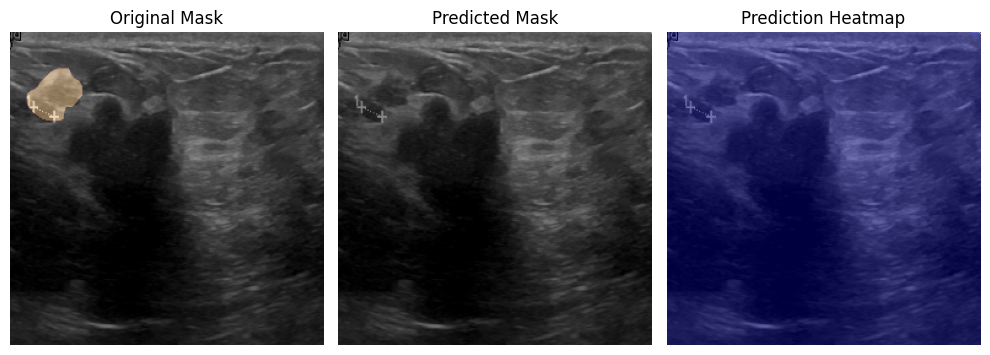

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - IoU: 0.4239 - accuracy: 0.7979 - loss: 256986368.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 61553060.0000
Epoch 45/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/steptep - IoU: 0.4416 - accuracy: 0.8578 - loss: 154148160.000


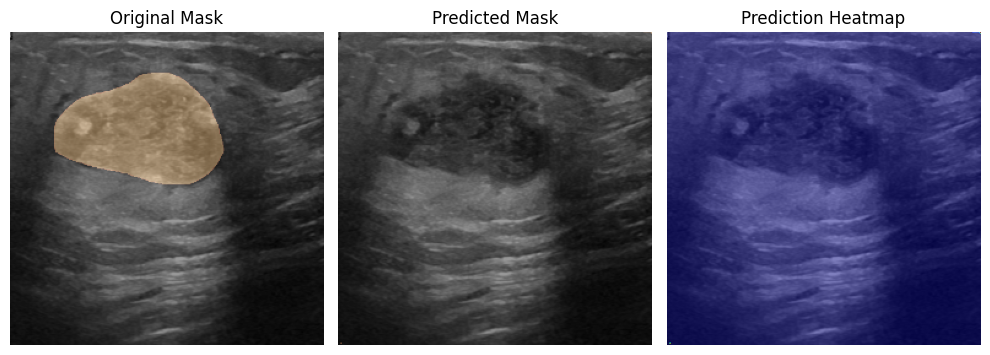

29/29 ━━━━━━━━━━━━━━━━━━━━ 7s 225ms/step - IoU: 0.4407 - accuracy: 0.8577 - loss: 155119328.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 93630872.0000
Epoch 46/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step 0.4442 - accuracy: 0.8549 - loss: 181863840.000


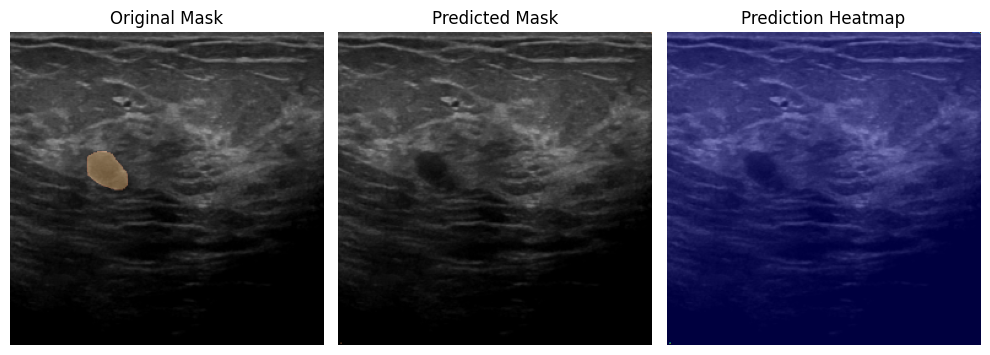

29/29 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - IoU: 0.4442 - accuracy: 0.8549 - loss: 181863840.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 91648144.0000
Epoch 47/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - IoU: 0.4391 - accuracy: 0.8508 - loss: 230164496.000


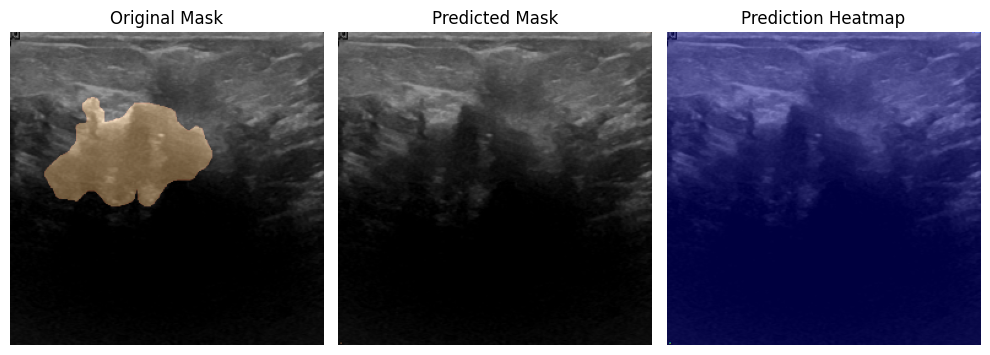

29/29 ━━━━━━━━━━━━━━━━━━━━ 6s 222ms/step - IoU: 0.4383 - accuracy: 0.8509 - loss: 230692528.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 130721976.0000
Epoch 48/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step 0.4123 - accuracy: 0.7677 - loss: 583790464.000


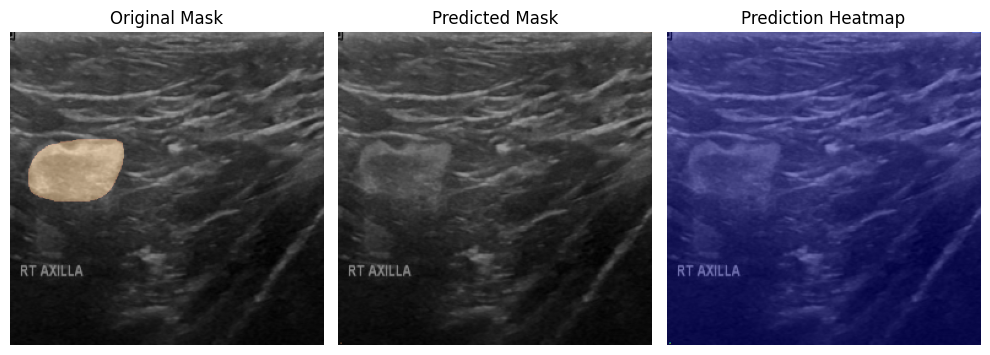

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 40ms/step - IoU: 0.4123 - accuracy: 0.7677 - loss: 583790464.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 134168536.0000
Epoch 49/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/steptep - IoU: 0.4394 - accuracy: 0.8512 - loss: 332651104.000


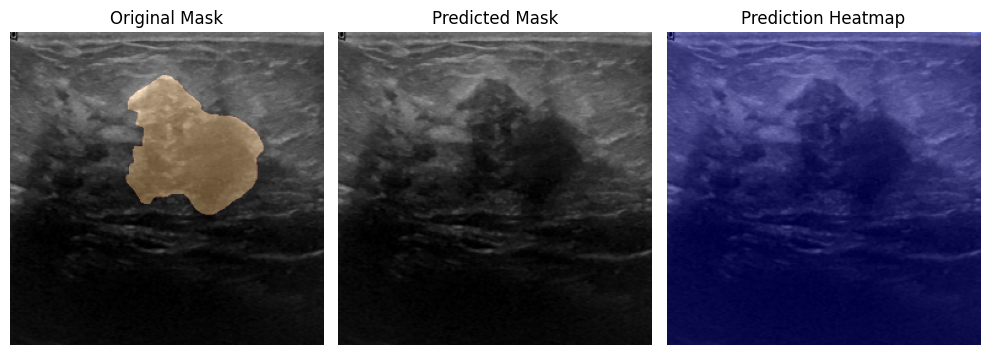

29/29 ━━━━━━━━━━━━━━━━━━━━ 7s 228ms/step - IoU: 0.4386 - accuracy: 0.8512 - loss: 334184864.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 213126192.0000
Epoch 50/50
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step 0.3651 - accuracy: 0.6631 - loss: 1227071360.000


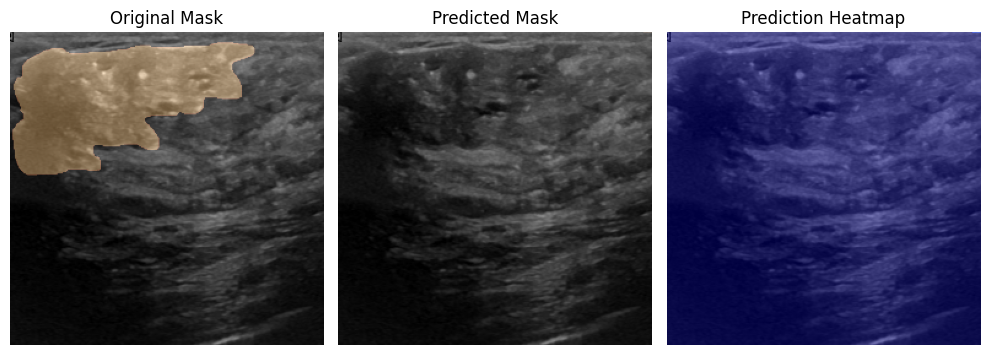

29/29 ━━━━━━━━━━━━━━━━━━━━ 1s 44ms/step - IoU: 0.3651 - accuracy: 0.6631 - loss: 1227071360.0000 - val_IoU: 0.4651 - val_accuracy: 0.9282 - val_loss: 218049296.0000


In [ ]:
# Config Training
BATCH_SIZE = 16
SPE = len(train_images) // BATCH_SIZE

# Check for NaNs in data
print("Checking for NaNs in training images:", np.isnan(train_images).sum())
print("Checking for NaNs in training masks:", np.isnan(train_masks).sum())
print("Checking for NaNs in validation images:", np.isnan(val_images).sum())
print("Checking for NaNs in validation masks:", np.isnan(val_masks).sum())

# Training with  callback
results = model.fit(
    train_images, train_masks,
    validation_data=(val_images, val_masks),
    epochs=50,
    steps_per_epoch=SPE,
    batch_size=BATCH_SIZE,
    callbacks=cb
)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


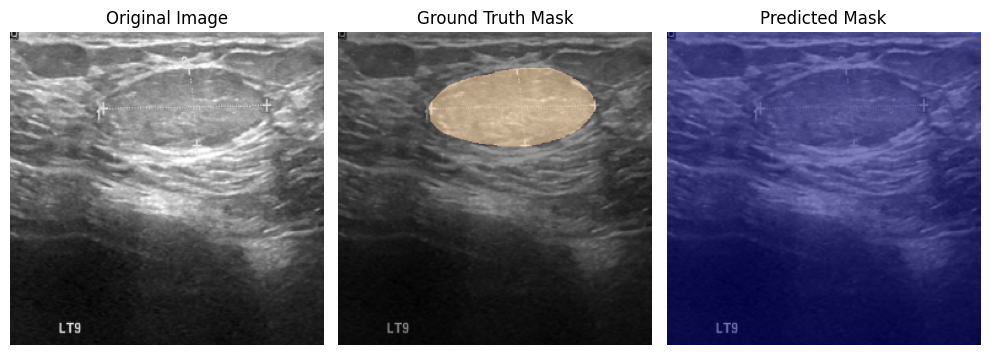

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


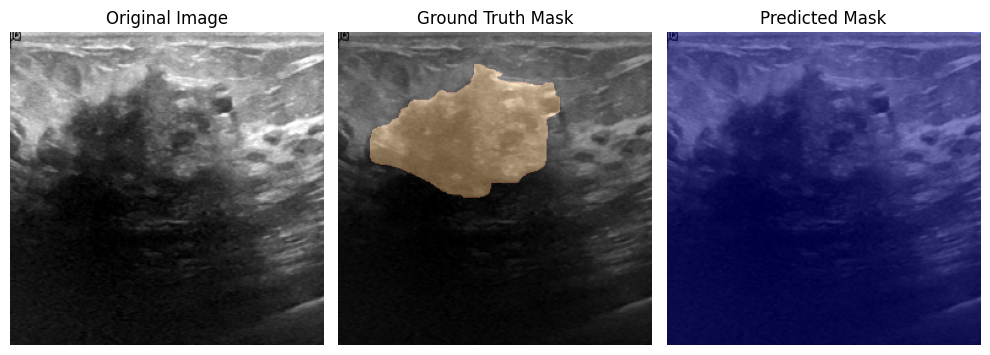

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


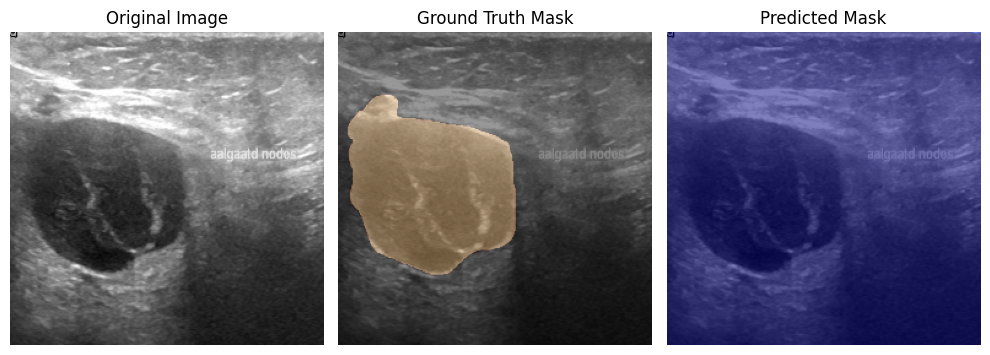

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


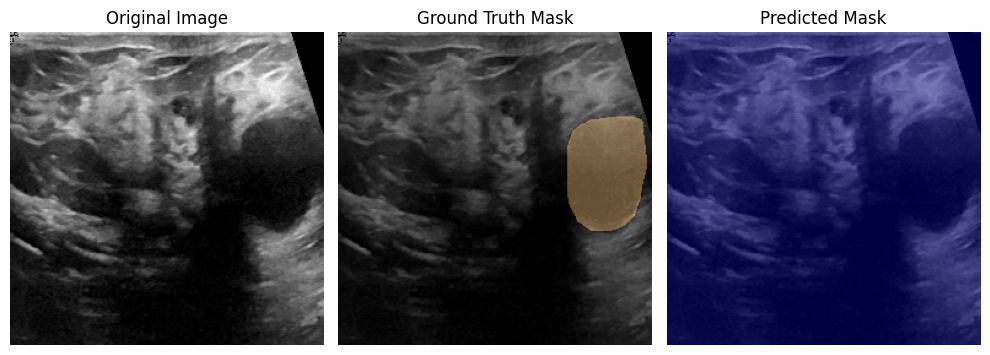

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


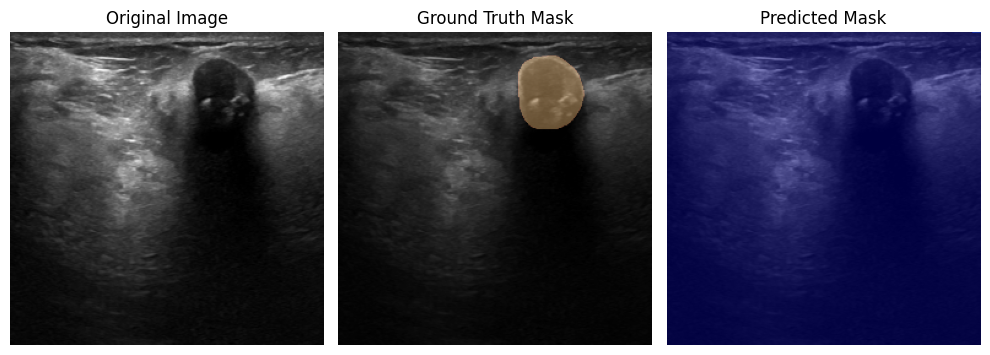

In [ ]:


# visualize predictions on unseen images
def visualize_predictions(model, images, masks, num_images=5):
    indices = np.random.choice(len(images), num_images, replace=False)
    for idx in indices:
        image = images[idx]
        mask = masks[idx]
        pred_mask = model.predict(image[np.newaxis, ...])[0]

        plt.figure(figsize=(10, 5))

        plt.subplot(1, 3, 1)
        plt.title("Original Image")
        show_image(image)

        plt.subplot(1, 3, 2)
        plt.title("Ground Truth Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1, 3, 3)
        plt.title("Predicted Mask")
        plt.imshow(image)
        plt.imshow(pred_mask, cmap='jet', alpha=0.5)
        plt.axis('off')

        plt.tight_layout()
        plt.show()

#predictions on 5 random test images
visualize_predictions(model, test_images, test_masks, num_images=5)


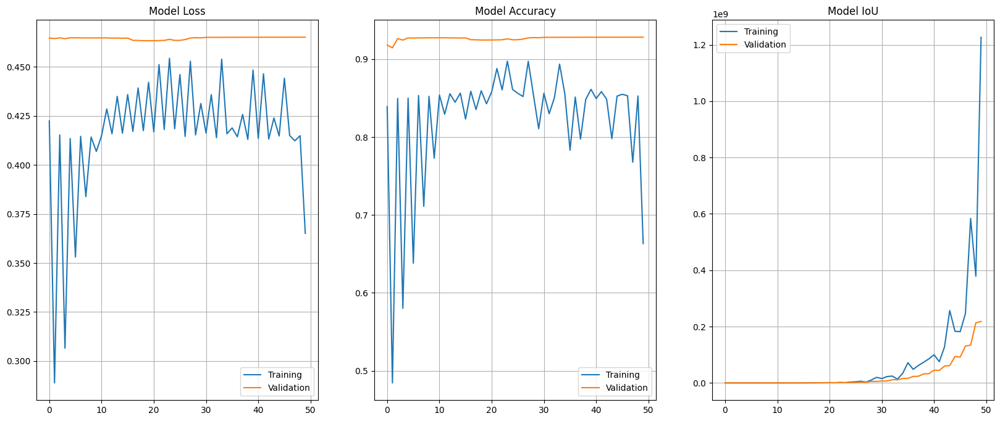

In [ ]:
loss, accuracy, iou, val_loss, val_accuracy, val_iou = results.history.values()

plt.figure(figsize=(20, 8))
plt.subplot(1, 3, 1)
plt.title("Model Loss")
plt.plot(loss, label="Training")
plt.plot(val_loss, label="Validation")
plt.legend()
plt.grid()

plt.subplot(1, 3, 2)
plt.title("Model Accuracy")
plt.plot(accuracy, label="Training")
plt.plot(val_accuracy, label="Validation")
plt.legend()
plt.grid()

plt.subplot(1, 3, 3)
plt.title("Model IoU")
plt.plot(iou, label="Training")
plt.plot(val_iou, label="Validation")
plt.legend()
plt.grid()

plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


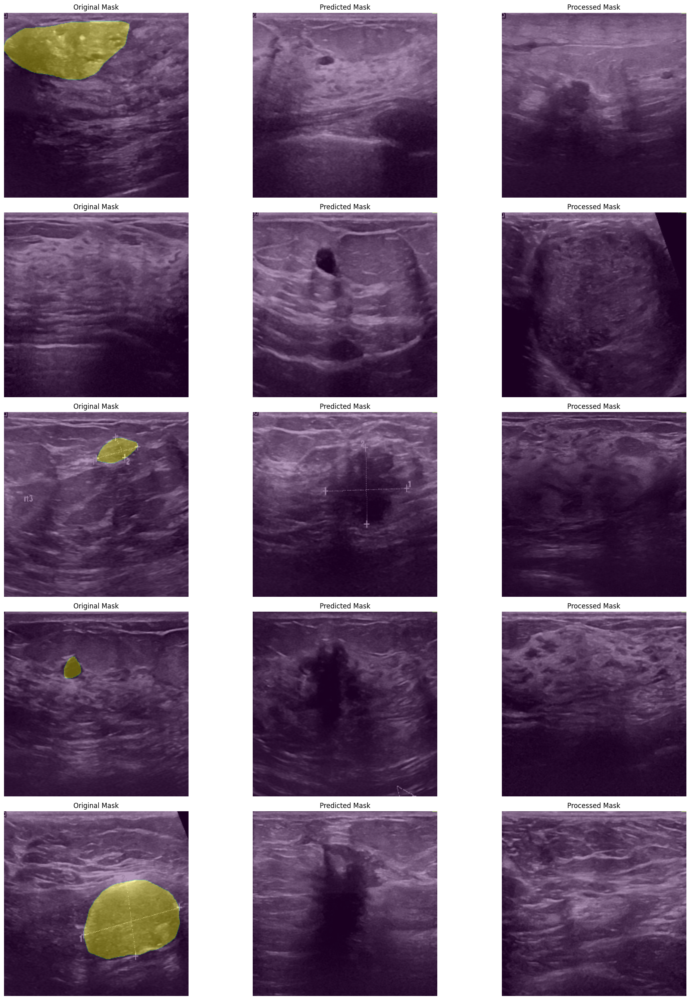

In [ ]:
plt.figure(figsize=(20, 25))
for i in range(15):
    plt.subplot(5, 3, i+1)
    idx = np.random.randint(len(images))
    image = images[idx]
    mask = masks[idx]
    pred_mask = model.predict(image[np.newaxis, ...])

    if i % 3 == 0:
        plt.title("Original Mask")
        show_mask(image, mask)
    elif i % 3 == 1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
    else:
        pred_mask = (pred_mask > 0.5).astype('float32')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)

plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


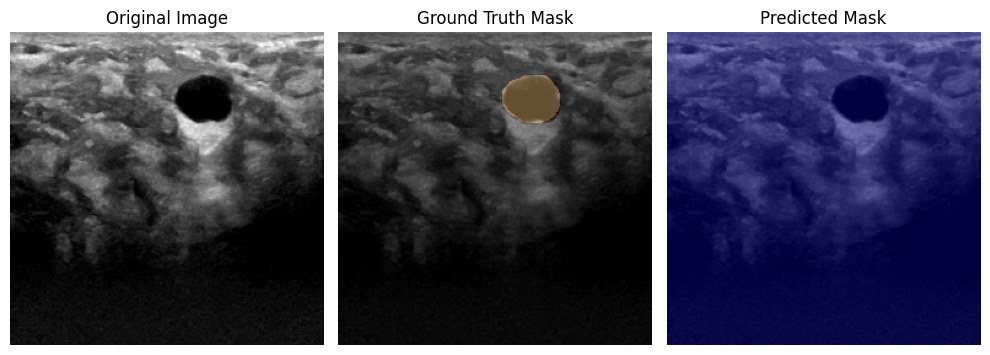

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


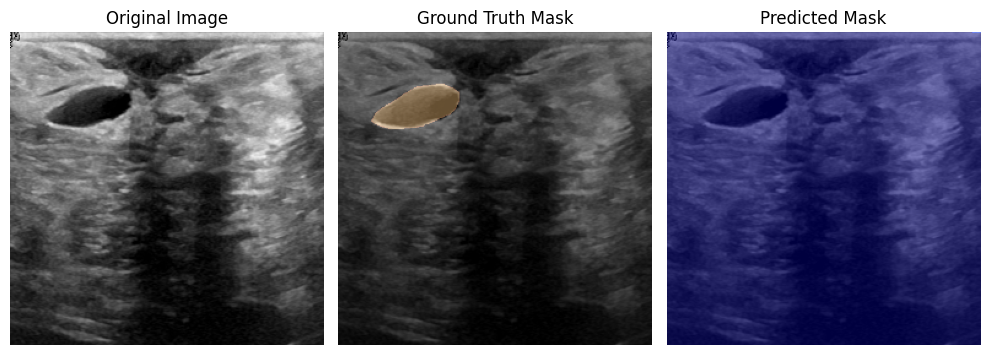

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


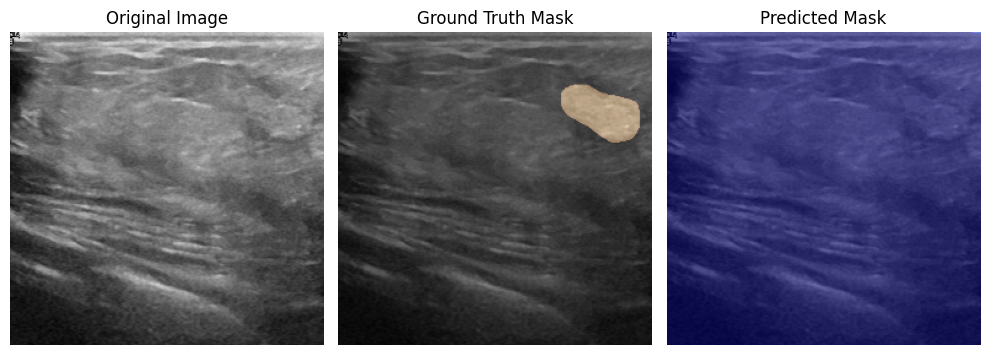

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


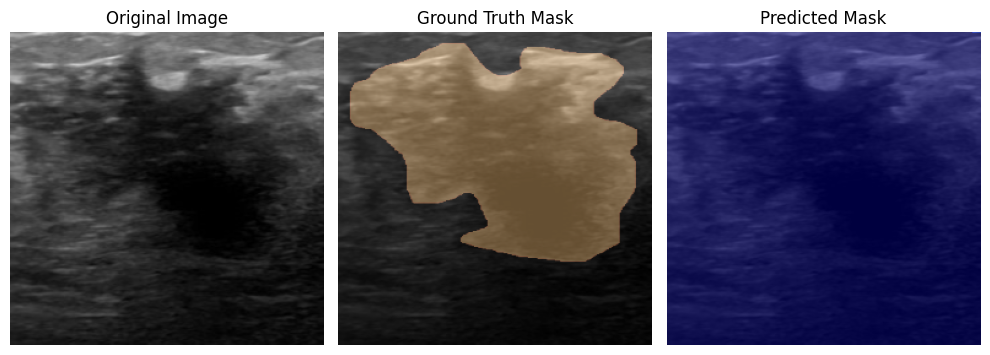

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


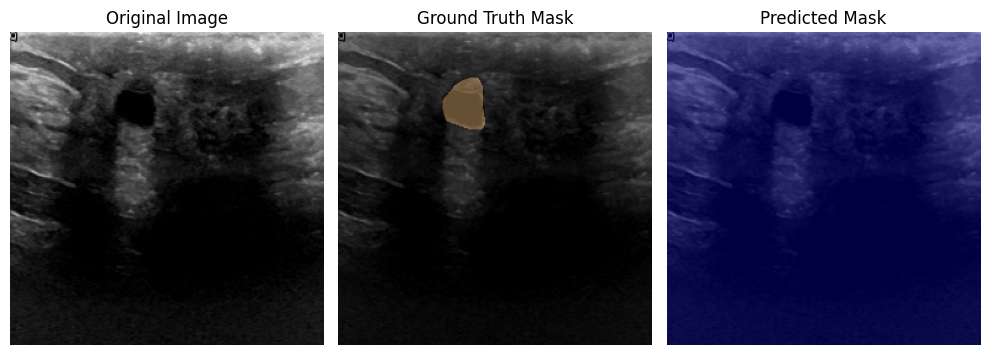

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# visualize predictions on a specified number of unseen images
def visualize_predictions(model, images, masks, num_images=5):
    indices = np.random.choice(len(images), num_images, replace=False)
    for idx in indices:
        image = images[idx]
        mask = masks[idx]
        pred_mask = model.predict(image[np.newaxis, ...])[0]

        plt.figure(figsize=(10, 5))

        plt.subplot(1, 3, 1)
        plt.title("Original Image")
        show_image(image)

        plt.subplot(1, 3, 2)
        plt.title("Ground Truth Mask")
        show_mask(image, mask, cmap='copper')

        plt.subplot(1, 3, 3)
        plt.title("Predicted Mask")
        plt.imshow(image)
        plt.imshow(pred_mask, cmap='jet', alpha=0.5)
        plt.axis('off')

        plt.tight_layout()
        plt.show()

# predictions on 5 random test images
visualize_predictions(model, test_images, test_masks, num_images=5)


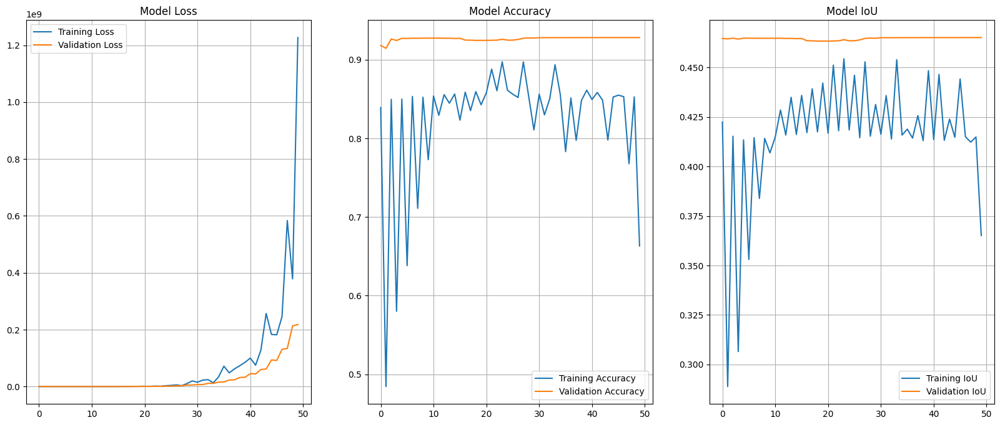

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


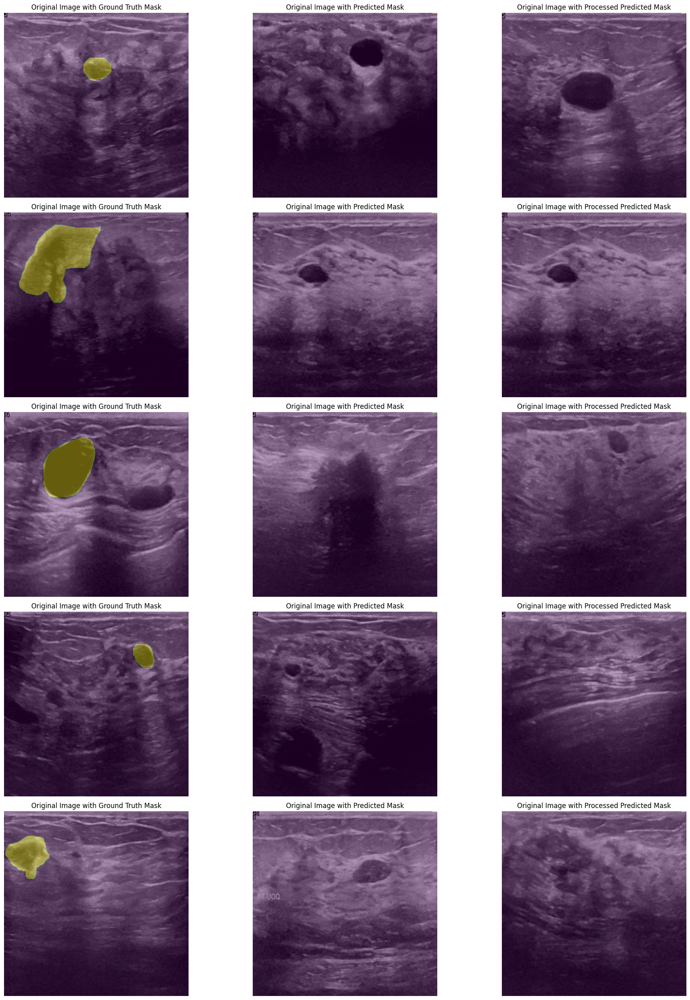

In [ ]:
# Extract history data
loss = results.history['loss']
val_loss = results.history['val_loss']
accuracy = results.history['accuracy']
val_accuracy = results.history['val_accuracy']
iou = results.history['IoU']
val_iou = results.history['val_IoU']

# Plot training history
plt.figure(figsize=(20, 8))

plt.subplot(1, 3, 1)
plt.title("Model Loss")
plt.plot(loss, label="Training Loss")
plt.plot(val_loss, label="Validation Loss")
plt.legend()
plt.grid()

plt.subplot(1, 3, 2)
plt.title("Model Accuracy")
plt.plot(accuracy, label="Training Accuracy")
plt.plot(val_accuracy, label="Validation Accuracy")
plt.legend()
plt.grid()

plt.subplot(1, 3, 3)
plt.title("Model IoU")
plt.plot(iou, label="Training IoU")
plt.plot(val_iou, label="Validation IoU")
plt.legend()
plt.grid()

plt.show()

# Visualize predictions on random images test_images
plt.figure(figsize=(20, 25))
for i in range(15):
    plt.subplot(5, 3, i + 1)
    idx = np.random.randint(len(test_images))
    image = test_images[idx]
    mask = test_masks[idx]
    pred_mask = model.predict(image[np.newaxis, ...])[0]

    if i % 3 == 0:
        plt.title("Original Image with Ground Truth Mask")
        show_mask(image, mask)
    elif i % 3 == 1:
        plt.title("Original Image with Predicted Mask")
        show_mask(image, pred_mask)
    else:
        pred_mask = (pred_mask > 0.5).astype('float32')
        plt.title("Original Image with Processed Predicted Mask")
        show_mask(image, pred_mask)

plt.tight_layout()
plt.show()
